# Computational Imaging

**Chini Tang**

**University of Arizona**

**Homework 2**

In [1]:
import numpy as np
from skimage import io
from skimage import color, data, restoration, exposure
from scipy.signal import convolve2d, convolve
from scipy.signal import bspline
import matplotlib.pyplot as plt
from google.colab import files
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 10]
plt.rcParams.update({'font.size': 22})

!wget https://download.chiantidatabase.org/CHIANTI_10.0.1_database.tar.gz
!mkdir dbase
!tar xvf CHIANTI_10.0.1_database.tar.gz -C dbase/

!pip3 install ChiantiPy
!pip3 install ipyparallel
%env XUVTOP=/content/dbase/


import ChiantiPy.core as ch
!wget --no-check-certificate --content-disposition 'https://github.com/djbradyAtOpticalSciencesArizona/computationalImaging/raw/master/images/snake.npy'

--2021-09-29 00:08:57--  https://download.chiantidatabase.org/CHIANTI_10.0.1_database.tar.gz
Resolving download.chiantidatabase.org (download.chiantidatabase.org)... 70.32.23.63
Connecting to download.chiantidatabase.org (download.chiantidatabase.org)|70.32.23.63|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 888202017 (847M) [application/x-gzip]
Saving to: ‘CHIANTI_10.0.1_database.tar.gz’

CHIANTI_10.0.1_data 100%[===================>] 847.05M   106MB/s    in 8.0s    

2021-09-29 00:09:05 (105 MB/s) - ‘CHIANTI_10.0.1_database.tar.gz’ saved [888202017/888202017]

README_CHIANTI
VERSION
abundance/
abundance/sun_coronal_2012_schmelz_ext.abund
abundance/cosmic_1973_allen.abund
abundance/sun_photospheric_2011_caffau.abund
abundance/sun_photospheric_2015_scott.abund
abundance/unity.abund
abundance/sun_coronal_1999_fludra_ext.abund
abundance/sun_photospheric_1998_grevesse.abund
abundance/sun_coronal_1992_feldman_ext.abund
abundance/sun_coronal_1999_fludra.abund
abu

img_psf = convolve2d(img_ori, psf, 'same')

**gaussian noise:** 

img_psf_gaussianBlur = img_psf + img_ori.std() * np.random.standard_normal(img_ori.shape) / snr

**poisson noise:**

img_psf_poissonBlur = img_psf + (rng.poisson(lam=25, size=img_psf.shape) - 10) / 255.

**wiener denoise algorithm:**


denoised = restoration.wiener(img_blur, psf, 1/snr)


**Richardson-Lucy denoise algorithm:**


denoised = restoration.richardson_lucy(img_blur, psf, iterations=100)


**Total variation denoise algorithm:**

denoised = denoise_tv_chambolle(img_blur, weight=0.2)

# Problem 1: (monochrome images)
Weiner, total variation, EM algorithm.

Image deblurring various types of blur (Gaussian, Poisson noise).

Compare reconstructions.

Analyze MSE with original images.

When capturing the image, it might be blurred by the system's PSF and noise.

So I manually blur the image by convolving PSF with original image and add a Gaussian noise to it.

In [ ]:
from skimage.restoration import denoise_tv_chambolle
from skimage import color, data, restoration, exposure, filters
from skimage.util import random_noise

def norm(arr):
  return arr / np.max(arr)


rng = np.random.default_rng()

# load the original image
img = np.load('snake.npy')
img = exposure.equalize_adapthist(img)

# set PSF of the system, and convolve the original image with it (Blur) -- 3 options
x,y = np.meshgrid(np.linspace(-3,3,32),np.linspace(-3,3,32))


psf = np.exp(-(x**2+y**2)/1) # Gaussian blur width=1
psf_width2 = np.exp(-(x**2+y**2)/2) # Gaussian blur width=2
psf_width5 = np.exp(-(x**2+y**2)/50) # Gaussian blur width=3

psf /= np.sum(psf)
psf_width2 /= np.sum(psf_width2)
psf_width5 /= np.sum(psf_width5)

img_psf = convolve2d(img, psf, 'same') # image after Gaussian blur width=1
img_psf_2 = convolve2d(img, psf_width2, 'same') # image after Gaussian blur width=2
img_psf_5 = convolve2d(img, psf_width5, 'same') # image after Gaussian blur width=5

# set signal to noise ratio and add the noise to the image (Noise)
snr = 10
img_psf_Gnoise = img_psf + img.std() * np.random.standard_normal(img.shape) / snr
img_psf_Pnosie_100 = rng.poisson(lam=img_psf * 100 / np.mean(img_psf), size = img_psf.shape)
img_psf_Pnosie_1000 = rng.poisson(lam=img_psf * 1000 / np.mean(img_psf), size = img_psf.shape)


img_psf_Gnoise_2 = img_psf_2 + img.std() * np.random.standard_normal(img.shape) / snr
img_psf_Pnosie_2_100 = rng.poisson(lam=img_psf_2 * 100 / np.mean(img_psf_2), size = img_psf_2.shape)
img_psf_Pnosie_2_1000 = rng.poisson(lam=img_psf_2 * 1000 / np.mean(img_psf_2), size = img_psf_2.shape)


img_psf_Gnoise_5 = img_psf_5 + img.std() * np.random.standard_normal(img.shape) / snr
img_psf_Pnosie_5_100 = rng.poisson(lam=img_psf_5 * 100 / np.mean(img_psf_5), size = img_psf_5.shape)
img_psf_Pnosie_5_1000 = rng.poisson(lam=img_psf_5 * 1000 / np.mean(img_psf_5), size = img_psf_5.shape)


# denoise with Weiner, TV, EM
img_Gdenoise_WE = restoration.wiener(norm(img_psf_Gnoise), psf, 1/snr)
img_Gdenoise_TV = denoise_tv_chambolle(norm(img_psf_Gnoise), weight=0.2)
img_Gdenoise_EM = restoration.richardson_lucy(norm(img_psf_Gnoise), psf, iterations=30)

img_Pdenoise_WE_100 = restoration.wiener(norm(img_psf_Pnosie_100), psf, 1/snr)
img_Pdenoise_TV_100 = denoise_tv_chambolle(norm(img_psf_Pnosie_100), weight=0.2)
img_Pdenoise_EM_100 = restoration.richardson_lucy(norm(img_psf_Pnosie_100), psf, iterations=30)

img_Pdenoise_WE_1000 = restoration.wiener(norm(img_psf_Pnosie_1000), psf, 1/snr)
img_Pdenoise_TV_1000 = denoise_tv_chambolle(norm(img_psf_Pnosie_1000), weight=0.2)
img_Pdenoise_EM_1000 = restoration.richardson_lucy(norm(img_psf_Pnosie_1000), psf, iterations=30)

img_Gdenoise_WE_2 = restoration.wiener(norm(img_psf_Gnoise_2), psf, 1/snr)
img_Gdenoise_TV_2 = denoise_tv_chambolle(norm(img_psf_Gnoise_2), weight=0.2)
img_Gdenoise_EM_2 = restoration.richardson_lucy(norm(img_psf_Gnoise_2), psf, iterations=30)

img_Pdenoise_WE_2_100 = restoration.wiener(norm(img_psf_Pnosie_2_100), psf, 1/snr)
img_Pdenoise_TV_2_100 = denoise_tv_chambolle(norm(img_psf_Pnosie_2_100), weight=0.2)
img_Pdenoise_EM_2_100 = restoration.richardson_lucy(norm(img_psf_Pnosie_2_100), psf, iterations=30)

img_Pdenoise_WE_2_1000 = restoration.wiener(norm(img_psf_Pnosie_2_1000), psf, 1/snr)
img_Pdenoise_TV_2_1000 = denoise_tv_chambolle(norm(img_psf_Pnosie_2_1000), weight=0.2)
img_Pdenoise_EM_2_1000 = restoration.richardson_lucy(norm(img_psf_Pnosie_2_1000), psf, iterations=30)

img_Gdenoise_WE_5 = restoration.wiener(norm(img_psf_Gnoise_5), psf, 1/snr)
img_Gdenoise_TV_5 = denoise_tv_chambolle(norm(img_psf_Gnoise_5), weight=0.2)
img_Gdenoise_EM_5 = restoration.richardson_lucy(norm(img_psf_Gnoise_5), psf, iterations=30)

img_Pdenoise_WE_5_100 = restoration.wiener(norm(img_psf_Pnosie_5_100), psf, 1/snr)
img_Pdenoise_TV_5_100 = denoise_tv_chambolle(norm(img_psf_Pnosie_5_100), weight=0.2)
img_Pdenoise_EM_5_100 = restoration.richardson_lucy(norm(img_psf_Pnosie_5_100), psf, iterations=30)

img_Pdenoise_WE_5_1000 = restoration.wiener(norm(img_psf_Pnosie_5_1000), psf, 1/snr)
img_Pdenoise_TV_5_1000 = denoise_tv_chambolle(norm(img_psf_Pnosie_5_1000), weight=0.2)
img_Pdenoise_EM_5_1000 = restoration.richardson_lucy(norm(img_psf_Pnosie_5_1000), psf, iterations=30)

In [ ]:
def plottings(img,noised_img,denoised_img,denoise_method):
  fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 10),sharex=True, sharey=True)
  ax[0].imshow(img, cmap='gray', vmin=np.min(denoised_img), vmax=np.max(denoised_img))
  ax[0].set_title('Original')
  ax[1].imshow(noised_img, cmap='gray', vmin=np.min(denoised_img), vmax=np.max(denoised_img))
  ax[1].set_title('Blur (Measured)')
  ax[2].imshow(denoised_img, cmap='gray')
  ax[2].set_title('Deblur with '+ denoise_method) 


# calculate mean square error
def mse(imageA, imageB):
	err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
	err /= float(imageA.shape[0] * imageA.shape[1])
	return err

## Plots

MSE of original image and noised image:    0.028908784574926676
MSE of original image and denoised image:    0.02491820509795284


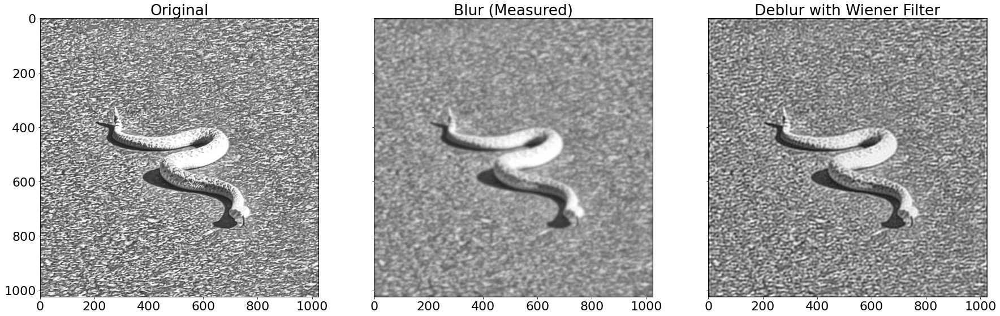

In [ ]:
# Gaussian blur width = 1, Gaussian noise, WE filter
plottings(img,img_psf_Gnoise,img_Gdenoise_WE,'Wiener Filter')
print("MSE of original image and noised image:   ", mse(img,img_psf_Gnoise))
print("MSE of original image and denoised image:   ", mse(img,img_Gdenoise_WE))

Wiener filter is suitable for the image with Gaussian noise due to the constant SNR of Gaussian noise.

MSE of original image and noised image:    0.02890880670525043
MSE of original image and denoised image:    0.036409330606700166


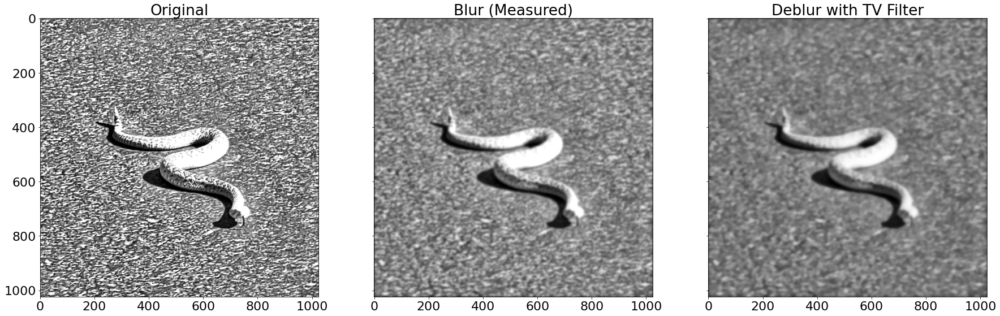

In [ ]:
# Gaussian blur width = 1, Gaussian noise, TV filter
plottings(img,img_psf_Gnoise,img_Gdenoise_TV,'TV Filter')
print("MSE of original image and noised image:   ", mse(img,img_psf_Gnoise))
print("MSE of original image and denoised image:   ", mse(img,img_Gdenoise_TV))

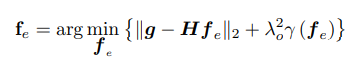

Total variance prevent gradiant explosion, which ɣf = ||∇f||. So we will see the denoised image looks smooth. However, this denoised method is not very suitable for this snake image with Gaussian noise, because Gaussian noise already decreases the image gradient, apply total variation doesn't help and even make the image more blurred. On the other hand, this total variance function doesn't do deconvolution, which makes image more blurred.

Total variance is more suitable for pepper salt noised image. Because pepper salt noise causes some large gradient of the portion of the image, and those portion is what we don't want and could be elimited by total variance denoised method. 

MSE of original image and noised image:    0.02890880670525043
MSE of original image and denoised image:    0.02702866207164548


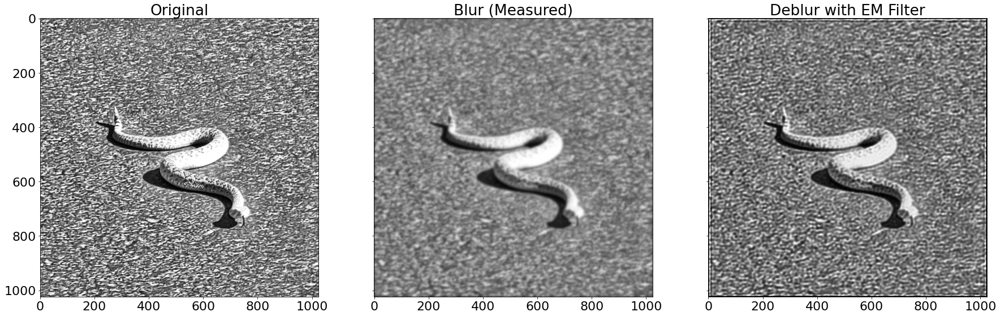

In [ ]:
# Gaussian blur width = 1, Gaussian noise, EM filter
plottings(img,img_psf_Gnoise,img_Gdenoise_EM,'EM Filter')
print("MSE of original image and noised image:   ", mse(img,img_psf_Gnoise))
print("MSE of original image and denoised image:   ", mse(img,img_Gdenoise_EM))

Richardson-Lucy algorithm generalizes to diverse EM algorithms based
on similar statistical arguments. It sharpen the blurred image. But it is not as good as wiener filter.

In [ ]:
def scale2range(arr):
  return ((arr - arr.min()) * (1/(arr.max() - arr.min())))

MSE of original image and noised image:   0.04558593386715322
MSE of original image and denoised image:   0.02745426998967287


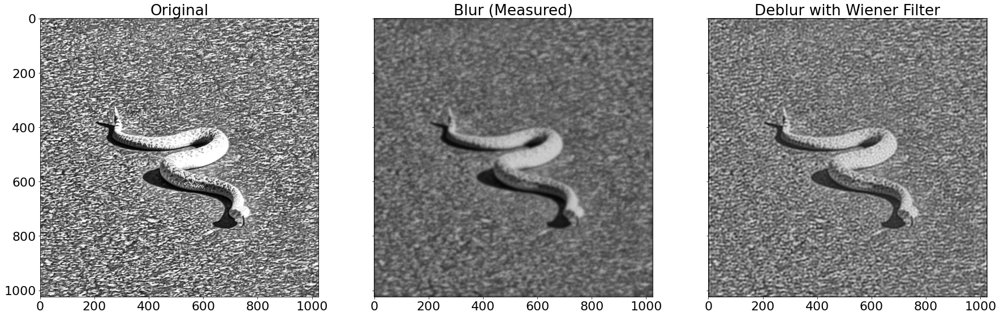

In [ ]:
# Gaussian blur width = 1, Poission noise photon number = 100, Wiener filter
plottings(scale2range(img), scale2range(img_psf_Pnosie_100), scale2range(img_Pdenoise_WE_100), 'Wiener Filter')
print('MSE of original image and noised image:  ', mse(scale2range(img),scale2range(img_psf_Pnosie_100)))
print('MSE of original image and denoised image:  ', mse(scale2range(img),scale2range(img_Pdenoise_WE_100)))

For Gaussian noise, each pixel will have the same SNR.

For Poisson noise, each pixel will have different SNR depending on each of their singal.

So, for wiener filter, Gaussian noise is more easier to eliminate due to the constant SNR for each frequency. As for Poisson noise, SNR depends on signal itself, each frequency might not have the same SNR, so it performs not as good as Gaussian noise. 

MSE of original image and noised image:    0.04558593386715322
MSE of original image and denoised image:    0.034823440251685864


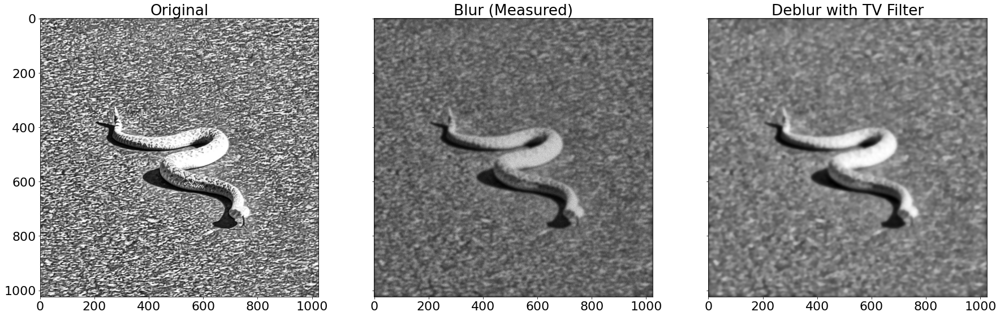

In [ ]:
# Gaussian blur width = 1, Poission noise photon number = 100, TV filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_100),scale2range(img_Pdenoise_TV_100), 'TV Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_100)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_TV_100)))

Total variance is more suitable for Poisson noise than Gaussian noise.

MSE of original image and noised image:    0.04558593386715322
MSE of original image and denoised image:    0.03843657493772623


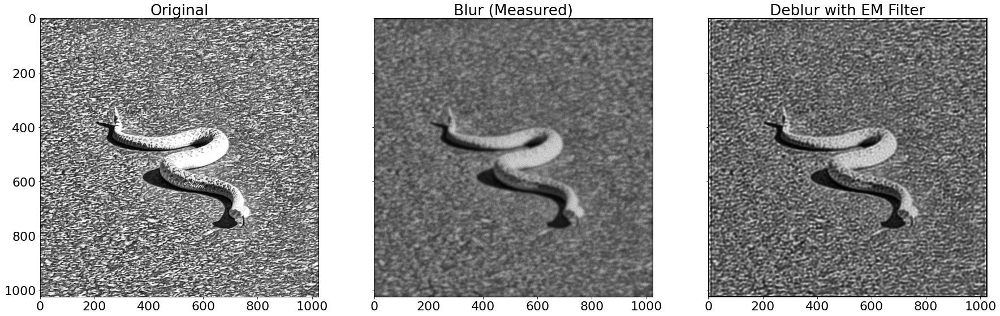

In [ ]:
# Gaussian blur width = 1, Poission noise photon number = 100, EM filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_100),scale2range(img_Pdenoise_EM_100), 'EM Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_100)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_EM_100)))

EM filter sharpen the blurred image, but it is not good at reconstruct possion noised image.

MSE of original image and noised image:    0.03277940045409143
MSE of original image and denoised image:    0.02404258901254085


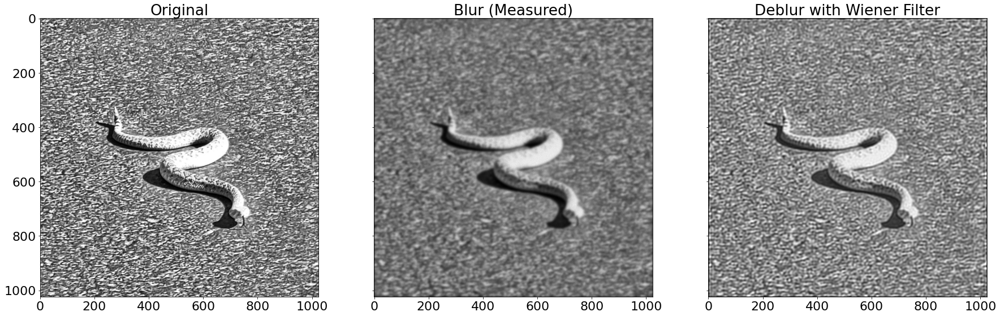

In [ ]:
# Gaussian blur width = 1, Poission noise photon number = 1000, Wiener Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_1000),scale2range(img_Pdenoise_WE_1000), 'Wiener Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_WE_1000)))

MSE of original image and noised image:    0.03277940045409143
MSE of original image and denoised image:    0.03454025803451323


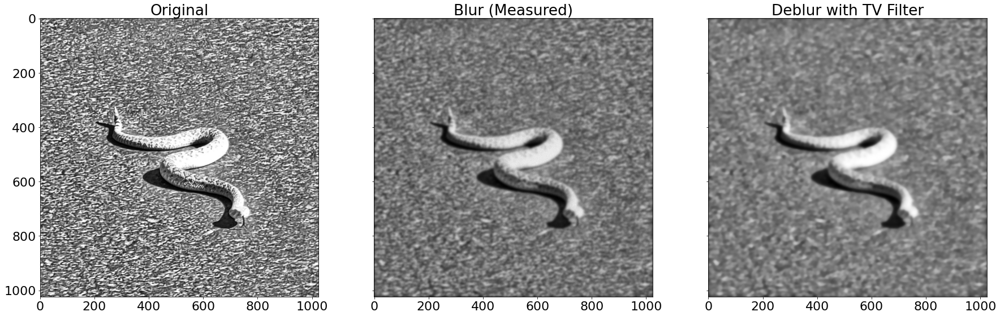

In [ ]:
# Gaussian blur width = 1, Poission noise photon number = 1000, TV Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_1000),scale2range(img_Pdenoise_TV_1000), 'TV Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_TV_1000)))

MSE of original image and noised image:    0.03277940045409143
MSE of original image and denoised image:    0.027217377452229307


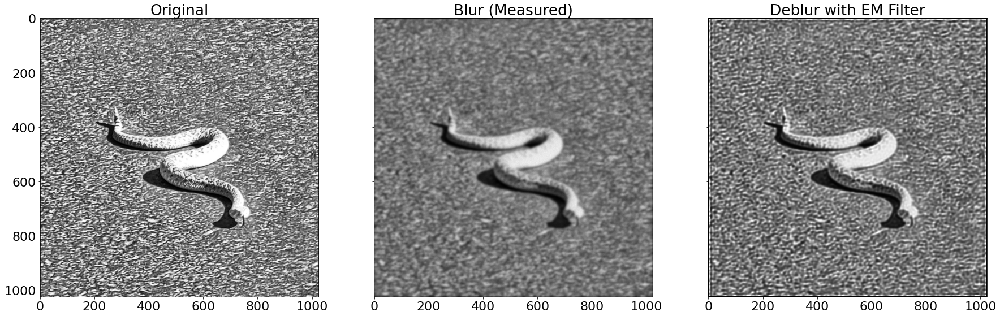

In [ ]:
# Gaussian blur width = 1, Poission noise photon number = 1000, EM Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_1000),scale2range(img_Pdenoise_EM_1000), 'EM Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_EM_1000)))

MSE of original image and noised image:    0.037185227490137154
MSE of original image and denoised image:    0.03217265981538626


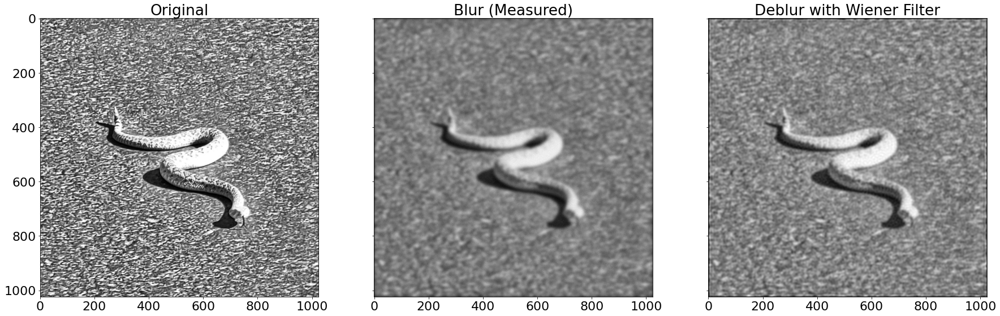

In [ ]:
# Gaussian blur width = 2, Gaussian noise, Wiener Filter
plottings(scale2range(img),scale2range(img_psf_Gnoise_2),scale2range(img_Gdenoise_WE_2),'Wiener Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Gnoise_2)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Gdenoise_WE_2)))

MSE of original image and noised image:    0.037185227490137154
MSE of original image and denoised image:    0.03929332580328122


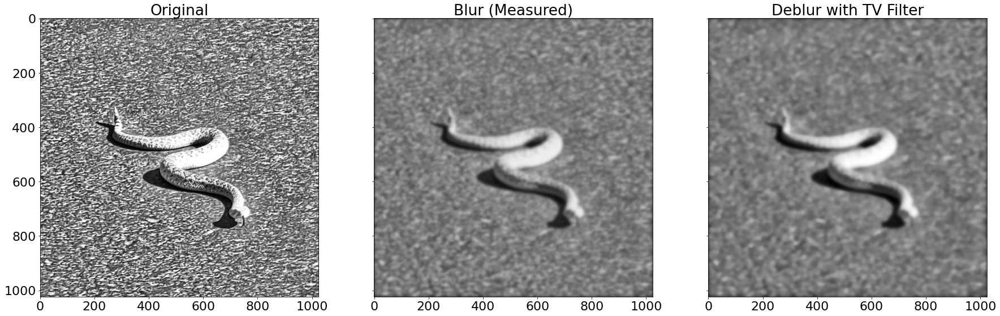

In [ ]:
# Gaussian blur width = 2, Gaussian noise, TV filter
plottings(scale2range(img),scale2range(img_psf_Gnoise_2),scale2range(img_Gdenoise_TV_2),'TV Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Gnoise_2)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Gdenoise_TV_2)))

MSE of original image and noised image:    0.037185227490137154
MSE of original image and denoised image:    0.035897507040223244


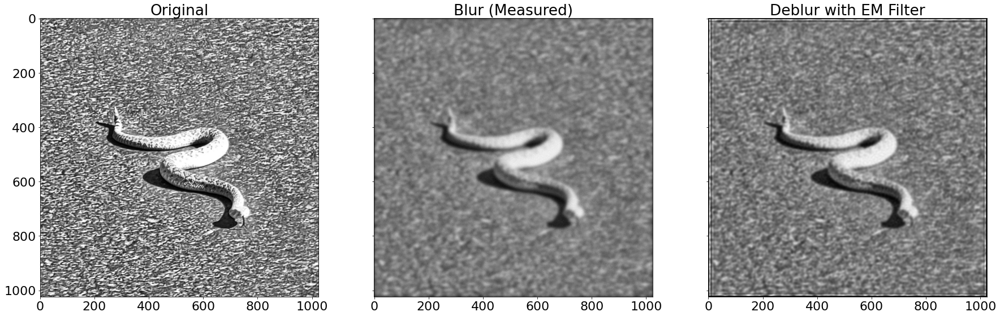

In [ ]:
# Gaussian blur width = 2, Gaussian noise, EM filter
plottings(scale2range(img),scale2range(img_psf_Gnoise_2),scale2range(img_Gdenoise_EM_2),'EM Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Gnoise_2)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Gdenoise_EM_2)))

MSE of original image and noised image:    0.057335079318276305
MSE of original image and denoised image:    0.03559179970960463


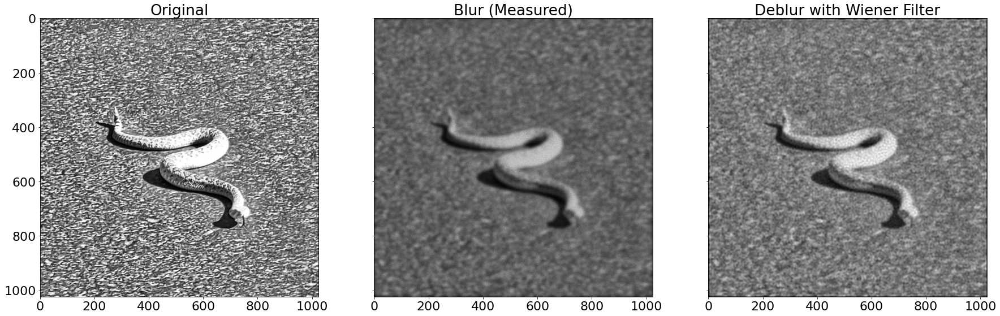

In [ ]:
# Gaussian blur width = 2, Poission noise photon number = 100, WE filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_2_100),scale2range(img_Pdenoise_WE_2_100),'Wiener Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_2_100)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_WE_2_100)))

MSE of original image and noised image:    0.057335079318276305
MSE of original image and denoised image:    0.03942089297201382


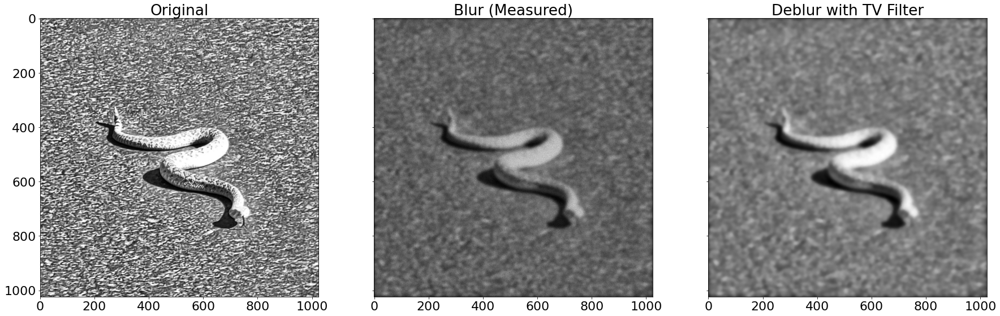

In [ ]:
# Gaussian blur width = 2, Poission noise photon number = 100, TV filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_2_100),scale2range(img_Pdenoise_TV_2_100), 'TV Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_2_100)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_TV_2_100)))

MSE of original image and noised image:    0.057335079318276305
MSE of original image and denoised image:    0.052202875709757665


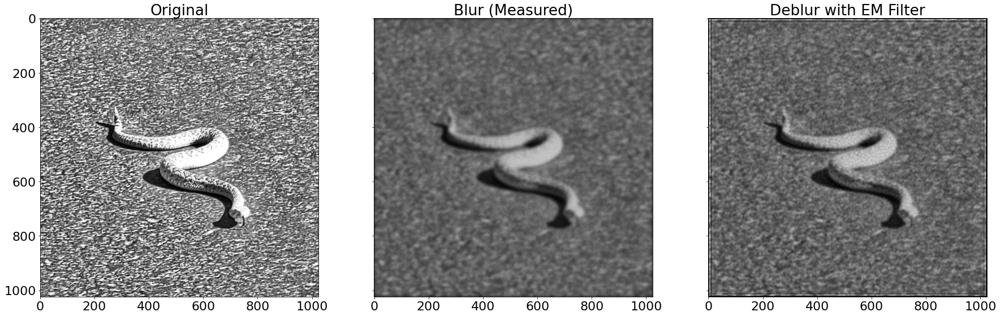

In [ ]:
# Gaussian blur width = 2, Poission noise photon number = 100, EM filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_2_100),scale2range(img_Pdenoise_EM_2_100), 'EM Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_2_100)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_EM_2_100)))

MSE of original image and noised image:    0.03981749820733341
MSE of original image and denoised image:    0.03205295042146535


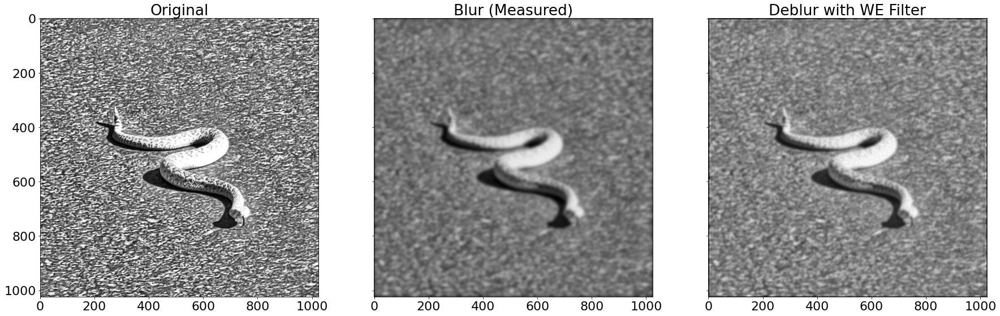

In [ ]:
# Gaussian blur width = 2, Poission noise photon number = 1000, Wiener filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_2_1000),scale2range(img_Pdenoise_WE_2_1000), 'Wiener filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_2_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_WE_2_1000)))

MSE of original image and noised image:    0.03981749820733341
MSE of original image and denoised image:    0.03957749047909205


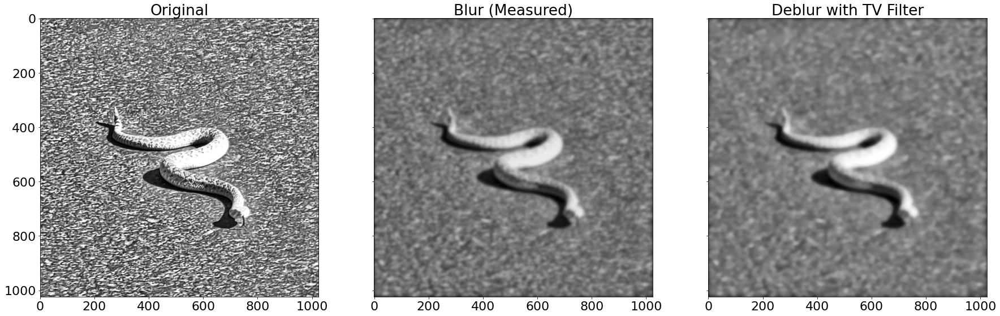

In [ ]:
# Gaussian blur width = 2, Poission noise photon number = 1000, TV Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_2_1000),scale2range(img_Pdenoise_TV_2_1000), 'TV Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_2_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_TV_2_1000)))

MSE of original image and noised image:    0.03981749820733341
MSE of original image and denoised image:    0.03624644040701018


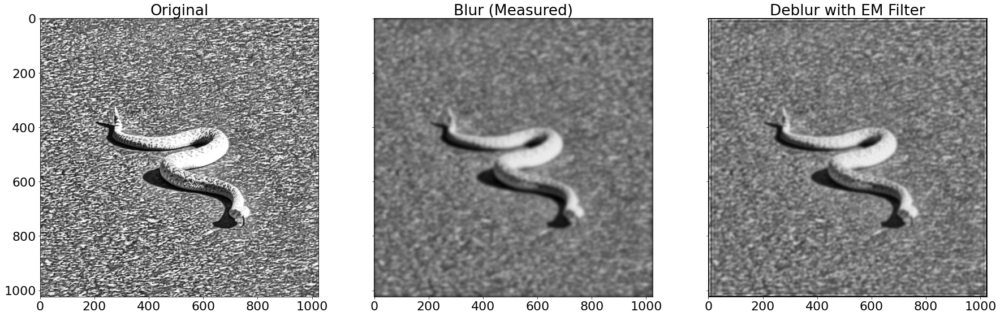

In [ ]:
# Gaussian blur width = 2, Poission noise photon number = 1000, EM Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_2_1000),scale2range(img_Pdenoise_EM_2_1000), 'EM Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_2_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_EM_2_1000)))

MSE of original image and noised image:    0.04482315445728829
MSE of original image and denoised image:    0.04639127651290784


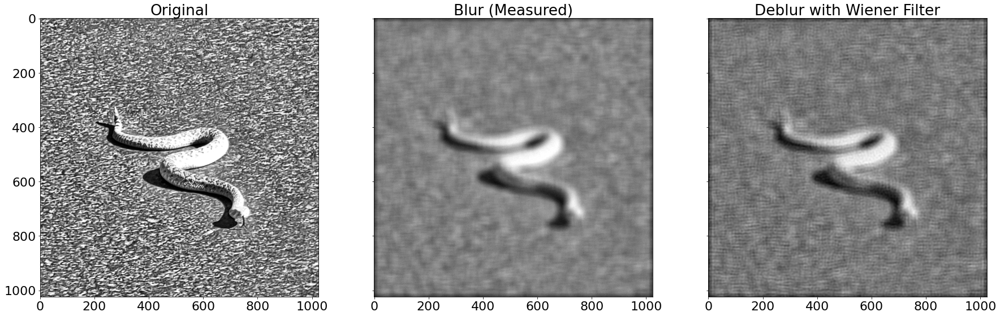

In [ ]:
# Gaussian blur width = 5, Gaussian noise, WE filter
plottings(img,img_psf_Gnoise_5,img_Gdenoise_WE_5,'Wiener Filter')
print("MSE of original image and noised image:   ", mse(img,img_psf_Gnoise_5))
print("MSE of original image and denoised image:   ", mse(img,img_Gdenoise_WE_5))

MSE of original image and noised image:    0.04482315445728829
MSE of original image and denoised image:    0.04574924148492489


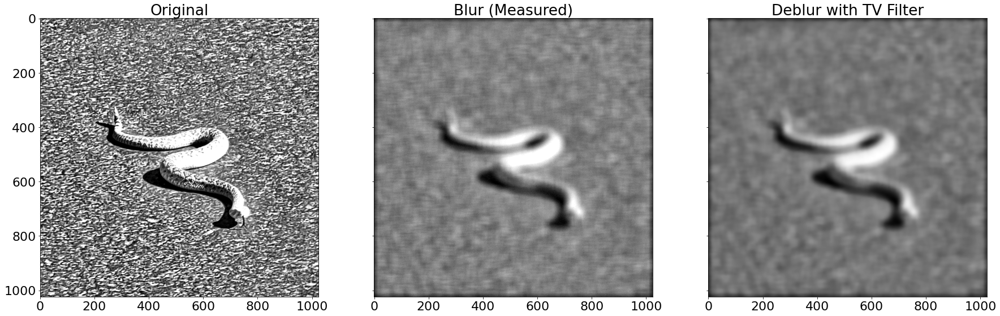

In [ ]:
# Gaussian blur width = 5, Gaussian noise, TV filter
plottings(img,img_psf_Gnoise_5,img_Gdenoise_TV_5,'TV Filter')
print("MSE of original image and noised image:   ", mse(img,img_psf_Gnoise_5))
print("MSE of original image and denoised image:   ", mse(img,img_Gdenoise_TV_5))

MSE of original image and noised image:    0.04482315445728829
MSE of original image and denoised image:    0.04843595498276398


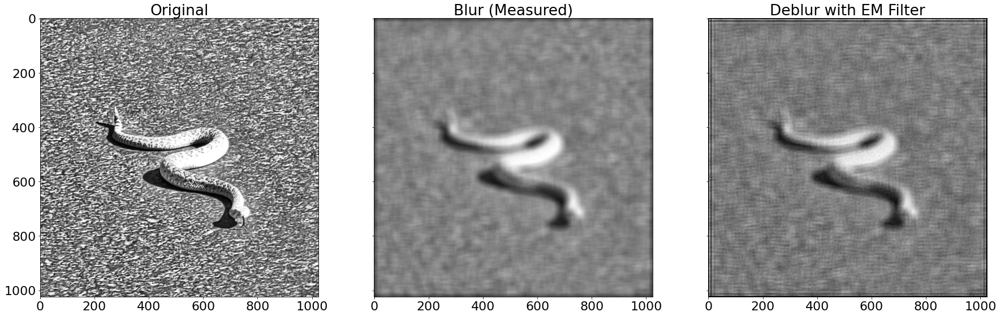

In [ ]:
# Gaussian blur width = 5, Gaussian noise, EM filter
plottings(img,img_psf_Gnoise_5,img_Gdenoise_EM_5,'EM Filter')
print("MSE of original image and noised image:   ", mse(img,img_psf_Gnoise_5))
print("MSE of original image and denoised image:   ", mse(img,img_Gdenoise_EM_5))

MSE of original image and noised image:    0.06103662638378625
MSE of original image and denoised image:    0.05243888248321805


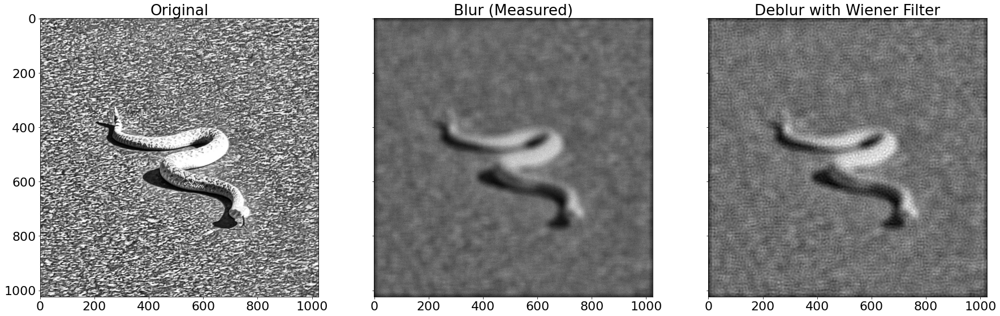

In [ ]:
# Gaussian blur width = 5, Poission noise photon number = 100, Wiener Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_5_100),scale2range(img_Pdenoise_WE_5_100),'Wiener Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_5_100)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_WE_5_100)))

MSE of original image and noised image:    0.06103662638378625
MSE of original image and denoised image:    0.04827329686293994


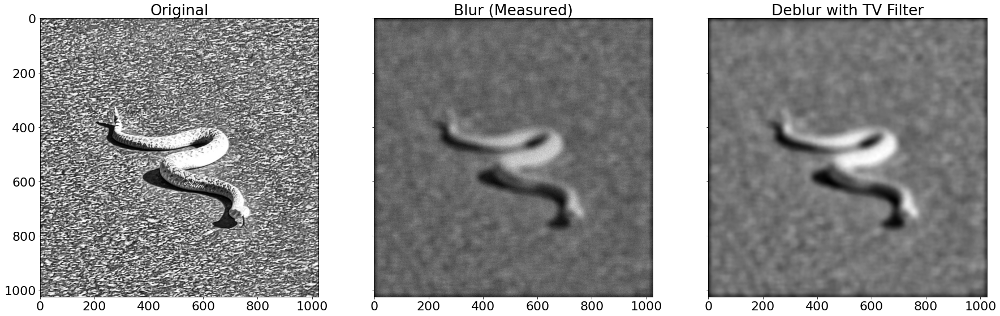

In [ ]:
# Gaussian blur width = 5, Poission noise photon number = 100, TV Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_5_100),scale2range(img_Pdenoise_TV_5_100),'TV Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_5_100)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_TV_5_100)))

MSE of original image and noised image:    0.06103662638378625
MSE of original image and denoised image:    0.057882798876972355


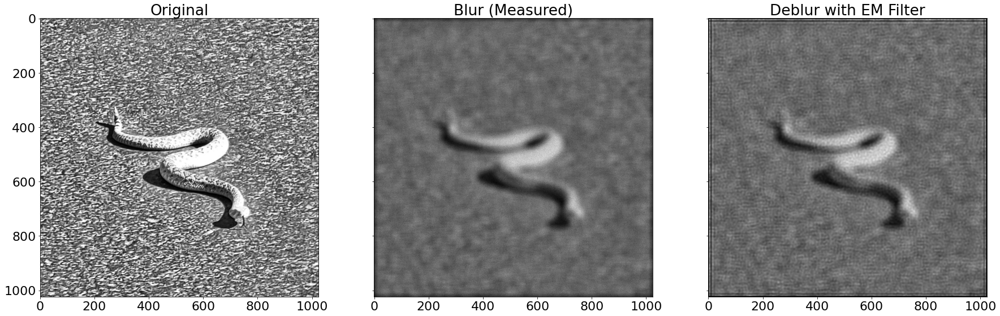

In [ ]:
# Gaussian blur width = 5, Poission noise photon number = 100, EM Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_5_100),scale2range(img_Pdenoise_EM_5_100),'EM Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_5_100)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_EM_5_100)))

MSE of original image and noised image:    0.051226242106244185
MSE of original image and denoised image:    0.04653627077874343


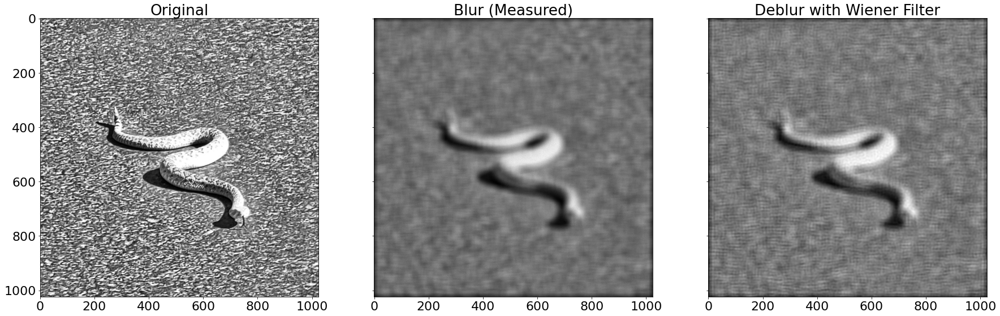

In [ ]:
# Gaussian blur width = 5, Poission noise photon number = 1000, Wiener Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_5_1000),scale2range(img_Pdenoise_WE_5_1000),'Wiener Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_5_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_WE_5_1000)))  

MSE of original image and noised image:    0.051226242106244185
MSE of original image and denoised image:    0.047904907283597635


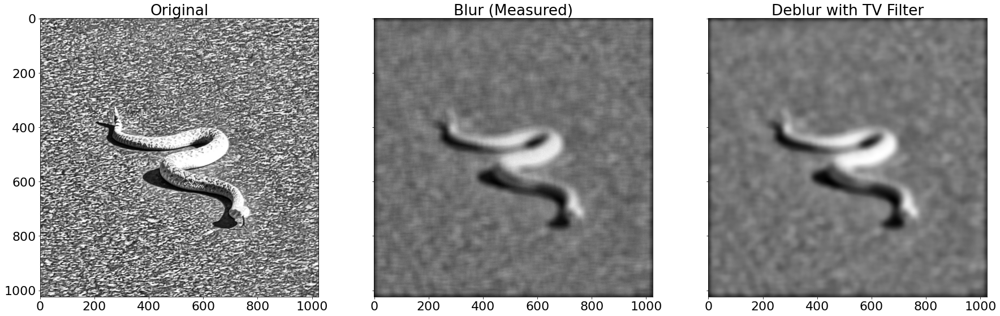

In [ ]:
# Gaussian blur width = 5, Poission noise photon number = 1000, TV Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_5_1000),scale2range(img_Pdenoise_TV_5_1000),'TV Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_5_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_TV_5_1000)))

MSE of original image and noised image:    0.051226242106244185
MSE of original image and denoised image:    0.04808554238062236


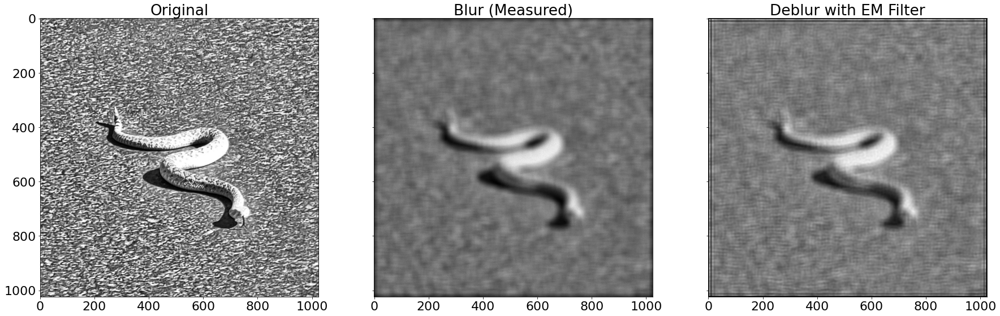

In [ ]:
# Gaussian blur width = 5, Poission noise photon number = 1000, EM Filter
plottings(scale2range(img),scale2range(img_psf_Pnosie_5_1000),scale2range(img_Pdenoise_EM_5_1000),'EM Filter')
print("MSE of original image and noised image:   ", mse(scale2range(img),scale2range(img_psf_Pnosie_5_1000)))
print("MSE of original image and denoised image:   ", mse(scale2range(img),scale2range(img_Pdenoise_EM_5_1000)))

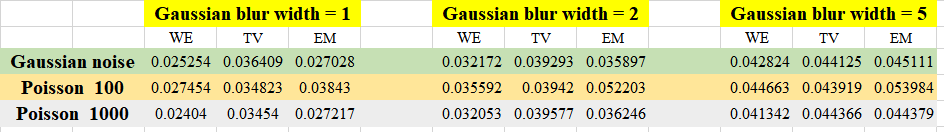

Wiener filter is the best for this snake image!
Wiener filter is relatively good at recover large photon number of Poisson noise image. Total variance is relatively good at handling poisson noise. EM filter is good at deblur Gaussian noise. Additionally, EM filter is relatively good at reconstruct poisson noise image with high photon number.

# Problem 2:
compare ordinary least squares, truncated SVD, Tikhonov and LASSO reconstructions for sparse spectra.

**OLS:**

fe=np.linalg.lstsq(H, np.matmul(H,fSig)+noiseLevel*np.random.normal(scale=1,size=(1024)))[0]

**truncated SVD:**

meas=np.matmul(H,fe14.Spectrum['intensity'])+noiseLevel*np.random.normal(scale=1,size=(1024))

Hr=np.matmul(np.matmul(np.transpose(vh[0:reduceRank,:]),np.diag(1./lam[0:reduceRank])),np.transpose(u[:,0:reduceRank]))

fe=np.matmul(Hr, meas)

**Tikhonov**

fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), meas)

**Lasso**

model = linear_model.Lasso(alpha=0.1)
model.fit(H,y)
fe=model.coef



sparse spectra

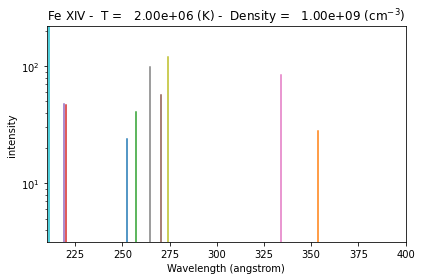

In [2]:
def sparse_spectra(spectra_name, wvl):
  t = 2000000
  fe14 = ch.ion(spectra_name, temperature=t, eDensity=1.e+9, em=1.e+27)
  fe14.intensityPlot(wvlRange=[210.,400.],linLog='log')
  fe14.spectrum(wvl)
  return fe14

wv = np.linspace(100,400,1024)
fe14 = sparse_spectra('fe_14', wv)

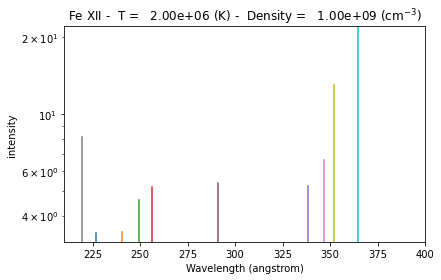

In [3]:
fe12 = sparse_spectra('fe_12', wv)

### Random noise

In [4]:
plt.rcParams['figure.figsize'] = [30, 10]
R=1024
H=np.random.random((R,1024))-.5
u, lam, vh = np.linalg.svd(H)

fe14 Random noise level = 1

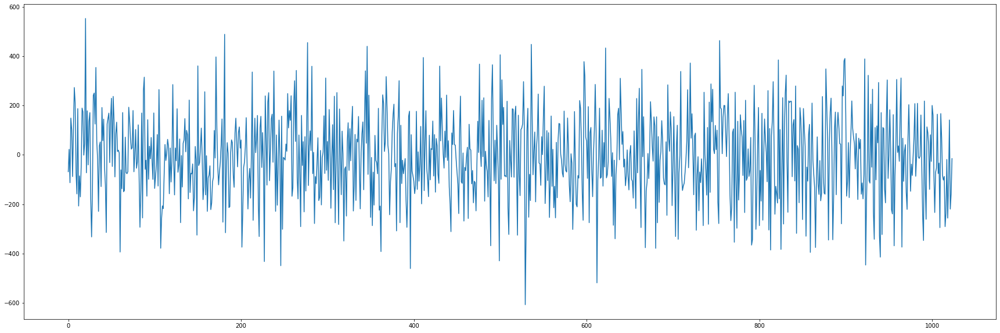

In [5]:
noiseLevel=1
fe14_meas_Rn1 = np.matmul(H,fe14.Spectrum['intensity']) + noiseLevel*np.random.normal(scale=1,size=(1024))
plt.plot(fe14_meas_Rn1)

fe14 Random noise level = 10

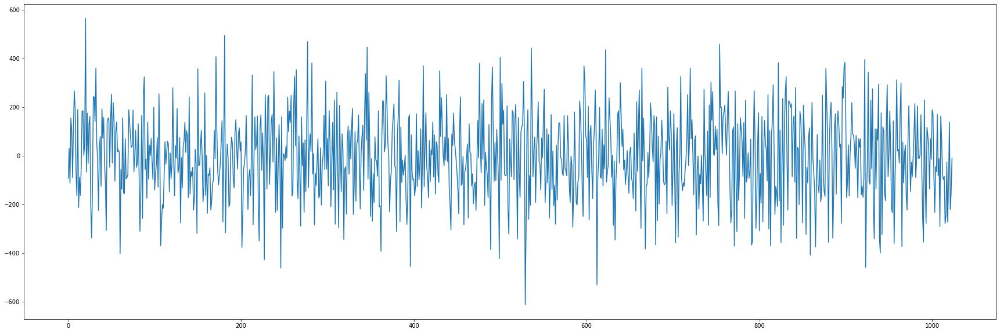

In [6]:
noiseLevel=10
fe14_meas_Rn10 = np.matmul(H,fe14.Spectrum['intensity']) + noiseLevel*np.random.normal(scale=1,size=(1024))
plt.plot(fe14_meas_Rn10)

fe12 Random noise level = 1

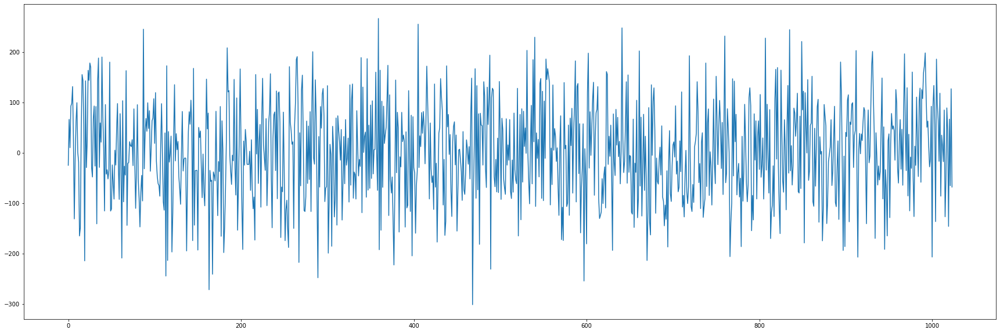

In [7]:
noiseLevel=1
fe12_meas_Rn1 = np.matmul(H,fe12.Spectrum['intensity']) + noiseLevel*np.random.normal(scale=1,size=(1024))
plt.plot(fe12_meas_Rn1)

fe12 Random noise level = 10

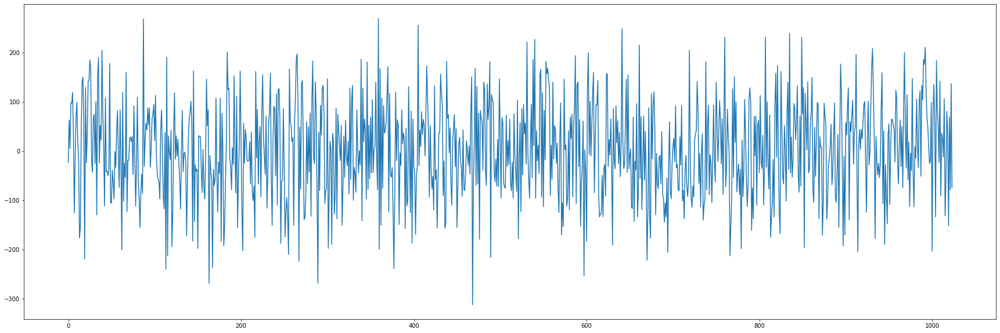

In [8]:
noiseLevel=10
fe12_meas_Rn10 = np.matmul(H,fe12.Spectrum['intensity']) + noiseLevel*np.random.normal(scale=1,size=(1024))
plt.plot(fe12_meas_Rn10)

Full rank random matrix with additive Gaussian noise (level=1) with fe14, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


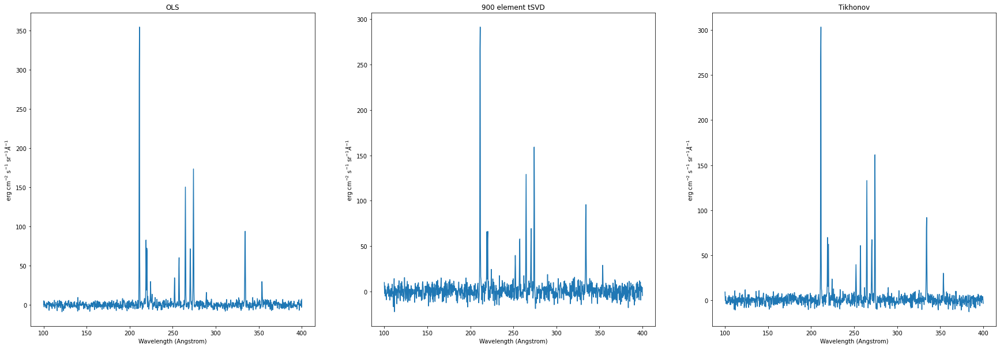

In [9]:
def plottings(fen,meas):
  plt.subplot(1,3,1)
  fe=np.linalg.lstsq(H,meas)[0]
  plt.plot(wv,fe)
  plt.xlabel(fen.Spectrum['xlabel'])
  plt.ylabel(fen.Spectrum['ylabel'])
  plt.title('OLS')

  plt.subplot(1,3,2)
  reduceRank=900
  Hr=np.matmul(np.matmul(np.transpose(vh[0:reduceRank,:]),np.diag(1./lam[0:reduceRank])),np.transpose(u[:,0:reduceRank]))
  fe=np.matmul(Hr, meas)
  plt.plot(wv,fe)
  plt.xlabel(fen.Spectrum['xlabel'])
  plt.ylabel(fen.Spectrum['ylabel'])
  plt.title('900 element tSVD')

  plt.subplot(1,3,3)
  lpam=1
  fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), meas)
  plt.plot(wv,fe)
  plt.xlabel(fen.Spectrum['xlabel'])
  plt.ylabel(fen.Spectrum['ylabel'])
  plt.title('Tikhonov')

plottings(fe14, fe14_meas_Rn1)

Full rank random matrix with additive Gaussian noise (level=10) with fe14, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


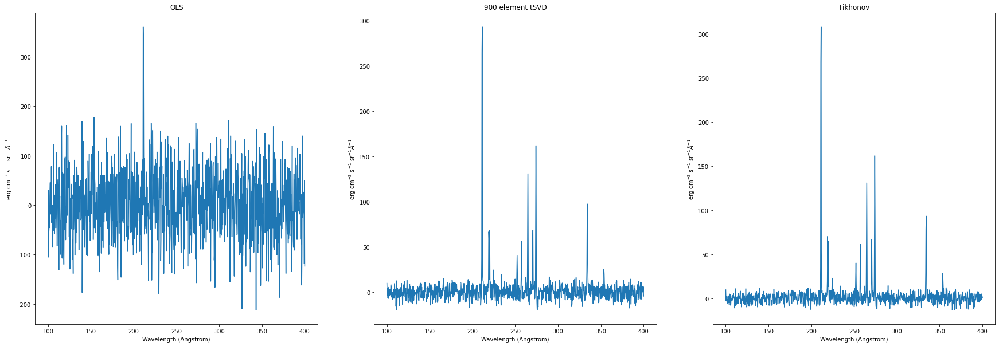

In [10]:
plottings(fe14, fe14_meas_Rn10)

Full rank random matrix with additive Gaussian noise(level=1) with fe12, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


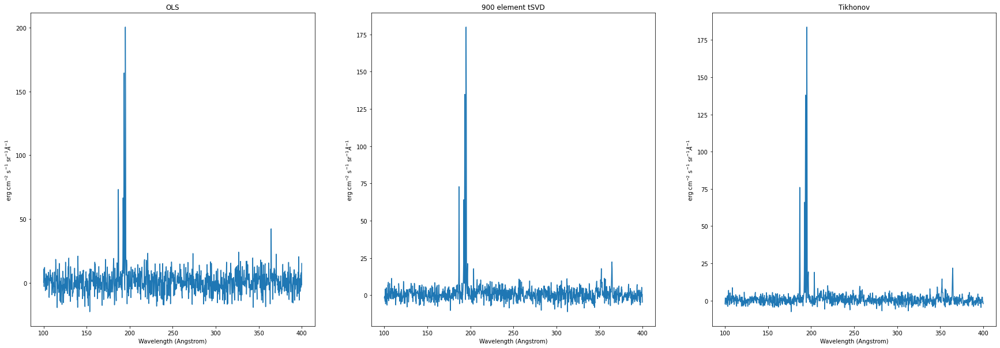

In [11]:
plottings(fe12, fe12_meas_Rn1)

Full rank random matrix with additive Gaussian noise(level=10) with fe12, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


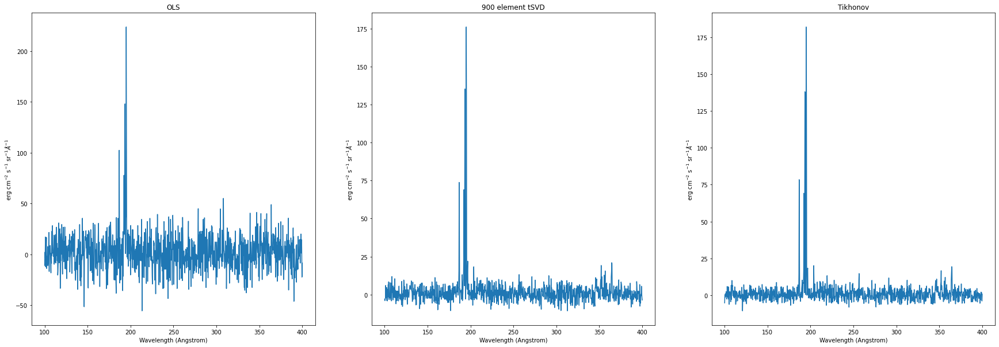

In [12]:
plottings(fe12, fe12_meas_Rn10)

With noise level increase, OLS is harder to recover the data.
tSVD is a biased estimator, the high frequency signal will remain even in the low noise level environments.

### Hadamard

In [38]:
from scipy.linalg import hadamard, toeplitz
R=1024
H = hadamard(1024) / 2
u, lam, vh = np.linalg.svd(H)

fe14 Hadamard noise level = 1

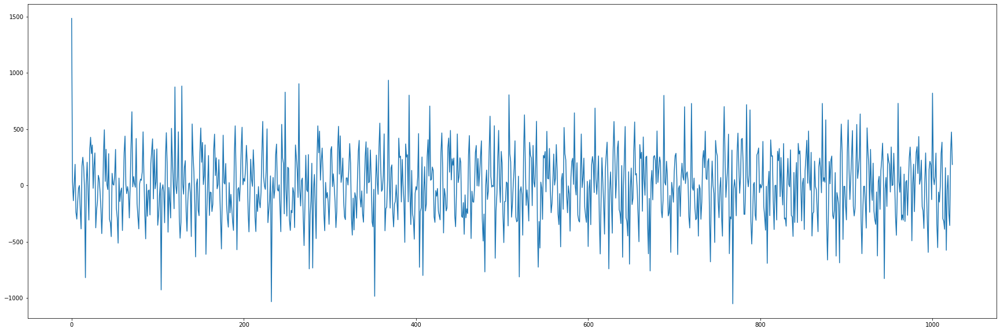

In [14]:
noiseLevel=1
fe14_meas_Hadn1 = np.matmul(H,fe14.Spectrum['intensity']) + noiseLevel * np.random.normal(scale=1,size=(1024))
plt.plot(fe14_meas_Hadn1)

fe14 Hadamard noise level = 10

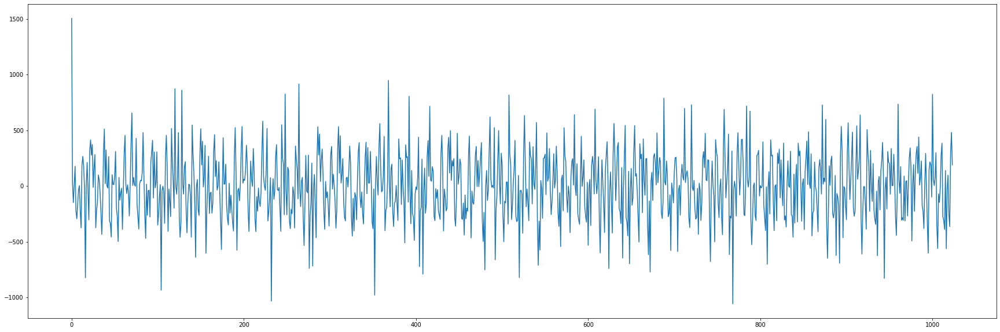

In [15]:
noiseLevel=10
fe14_meas_Hadn10 = np.matmul(H,fe14.Spectrum['intensity']) + noiseLevel * np.random.normal(scale=1,size=(1024))
plt.plot(fe14_meas_Hadn10)

fe12 Hadamard noise level = 1

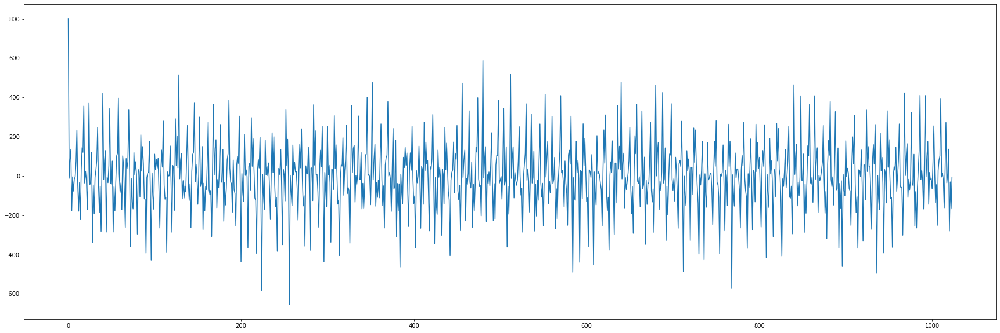

In [16]:
noiseLevel=1
fe12_meas_Hadn1 = np.matmul(H,fe12.Spectrum['intensity']) + noiseLevel * np.random.normal(scale=1,size=(1024))
plt.plot(fe12_meas_Hadn1)

fe12 Hadamard noise level = 10

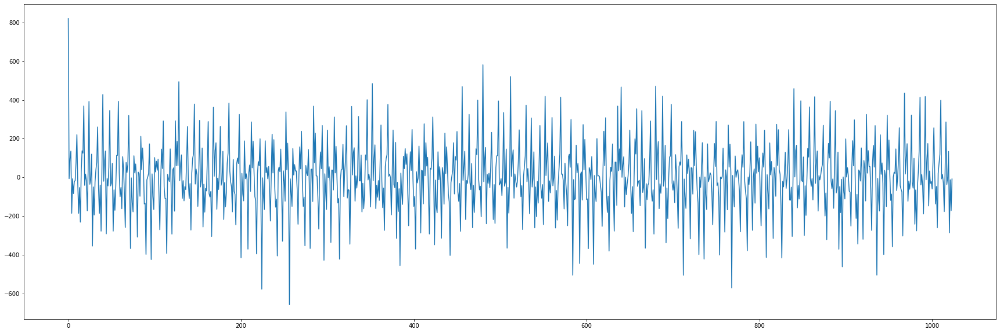

In [17]:
noiseLevel=10
fe12_meas_Hadn10 = np.matmul(H,fe12.Spectrum['intensity']) + noiseLevel * np.random.normal(scale=1,size=(1024))
plt.plot(fe12_meas_Hadn10)

hadamard matrix with additive Gaussian noise(level=1) fe14, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


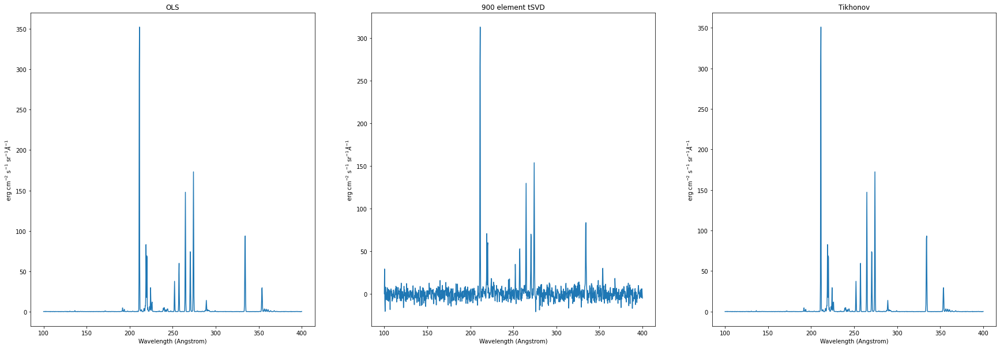

In [18]:
plottings(fe14, fe14_meas_Hadn1)

hadamard matrix with additive Gaussian noise(level=10) fe14, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


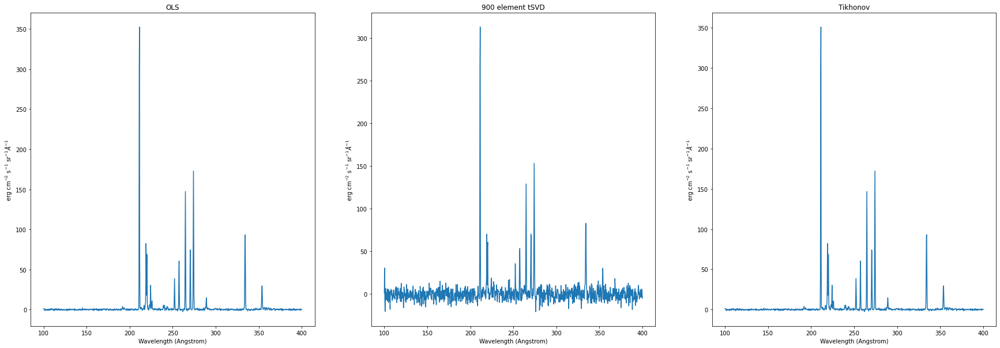

In [19]:
plottings(fe14, fe14_meas_Hadn10)

hadamard matrix with additive Gaussian noise(level=1) fe12, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


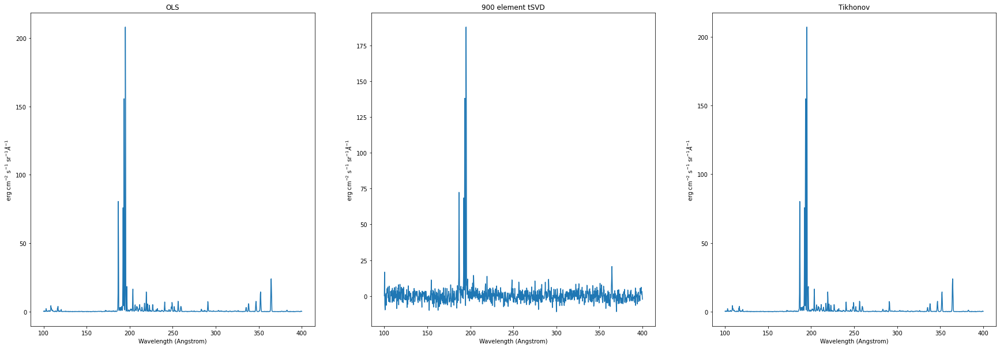

In [20]:
plottings(fe12, fe12_meas_Hadn1)

hadamard matrix with additive Gaussian noise(level=10) fe12, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  This is separate from the ipykernel package so we can avoid doing imports until


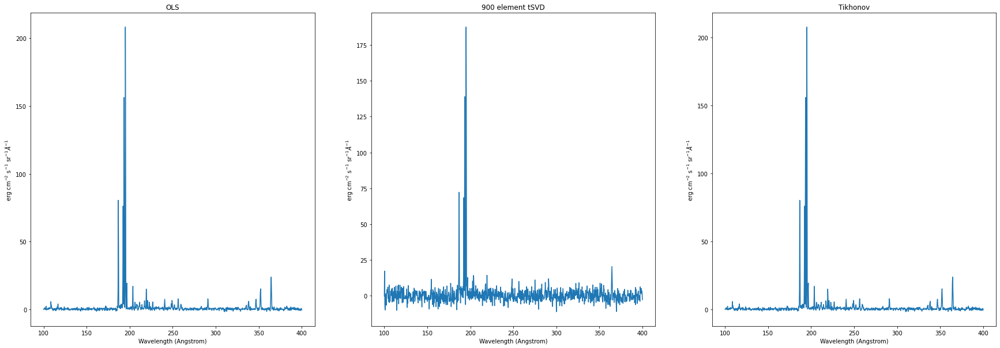

In [21]:
plottings(fe12, fe12_meas_Hadn10)

With Hadmard matrix, OLS and Tikonov is better than using tSVD.

### downsampling

In [22]:
def down_sample(ave_num, signal_length):    
    result = np.zeros((int(signal_length/ave_num),signal_length))
    base = (np.concatenate((np.ones((ave_num)), np.zeros((signal_length-ave_num)))).astype(int)).reshape(1,-1)
    for i in range(result.shape[0]):
        temp = np.roll(base, int(2*i))        
        result[i,:] = temp
    return result

def plottings_2(fen,meas):
  plt.subplot(1,3,1)
  fe=np.linalg.lstsq(H,meas)[0]
  plt.plot(wv,fe)
  plt.xlabel(fen.Spectrum['xlabel'])
  plt.ylabel(fen.Spectrum['ylabel'])
  plt.title('OLS')

  plt.subplot(1,3,2)
  reduceRank=450
  Hr=np.matmul(np.matmul(np.transpose(vh[0:reduceRank,:]),np.diag(1./lam[0:reduceRank])),np.transpose(u[:,0:reduceRank]))
  fe=np.matmul(Hr, meas)
  plt.plot(wv,fe)
  plt.xlabel(fen.Spectrum['xlabel'])
  plt.ylabel(fen.Spectrum['ylabel'])
  plt.title('900 element tSVD')

  plt.subplot(1,3,3)
  lpam=1
  fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), meas)
  plt.plot(wv,fe)
  plt.xlabel(fen.Spectrum['xlabel'])
  plt.ylabel(fen.Spectrum['ylabel'])
  plt.title('Tikhonov')

  
H = down_sample(2,1024) * 0.5
u, lam, vh = np.linalg.svd(H)

fe14 downsample noise level = 1

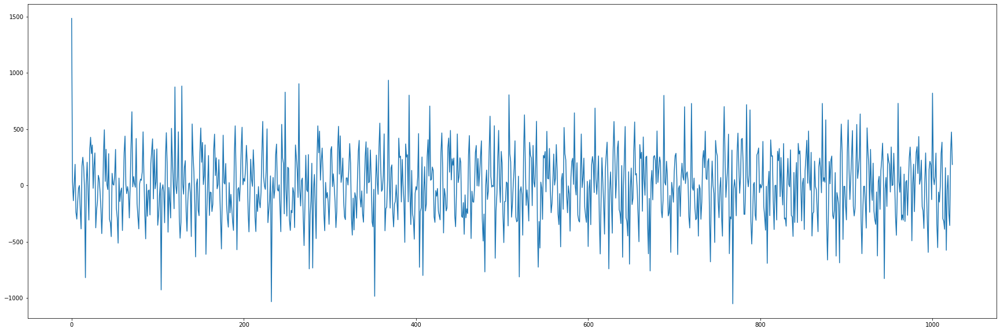

In [23]:
noiseLevel=1
fe14_meas_Dsn1 = np.matmul(H,fe14.Spectrum['intensity']) + noiseLevel * np.random.normal(scale=1,size=(H.shape[0]))
plt.plot(fe14_meas_Hadn1)

fe14 downsample noise level = 10

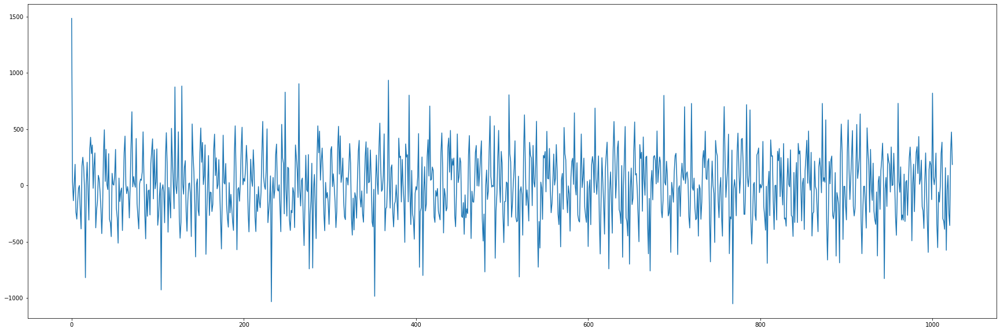

In [24]:
noiseLevel=10
fe14_meas_Dsn10 = np.matmul(H,fe14.Spectrum['intensity']) + noiseLevel * np.random.normal(scale=1,size=(H.shape[0]))
plt.plot(fe14_meas_Hadn1)

fe12 downsample noise level = 1

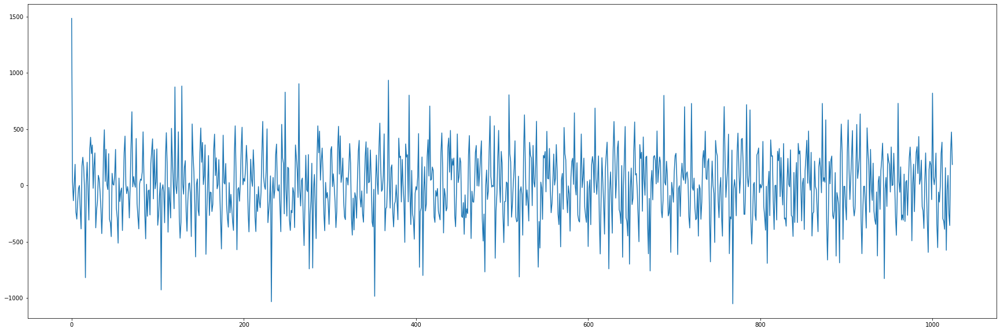

In [25]:
noiseLevel=1
fe12_meas_Dsn1 = np.matmul(H,fe12.Spectrum['intensity']) + noiseLevel * np.random.normal(scale=1,size=(H.shape[0]))
plt.plot(fe14_meas_Hadn1)

fe12 downsample noise level = 10

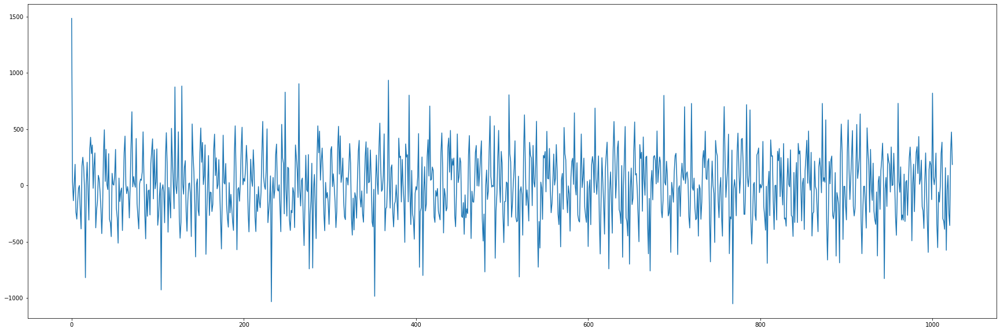

In [26]:
noiseLevel=10
fe12_meas_Dsn10 = np.matmul(H,fe12.Spectrum['intensity']) + noiseLevel * np.random.normal(scale=1,size=(H.shape[0]))
plt.plot(fe14_meas_Hadn1)

downsample with additive Gaussian noise(level=1) fe14, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  # This is added back by InteractiveShellApp.init_path()


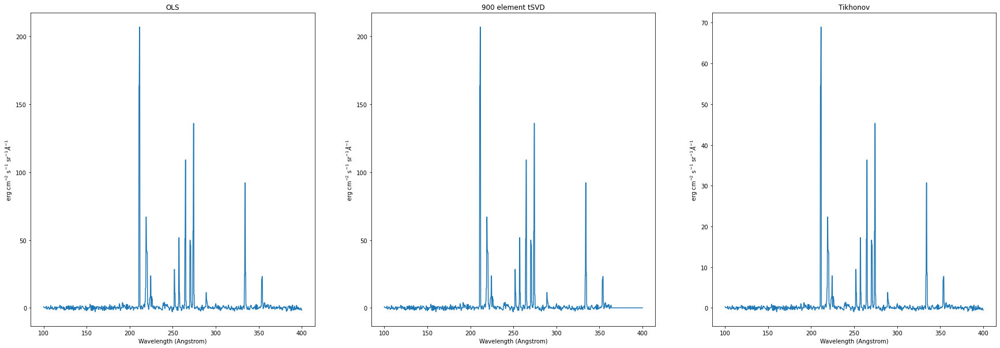

In [27]:
plottings_2(fe14,fe14_meas_Dsn1)

downsample with additive Gaussian noise(level=10) fe14, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  # This is added back by InteractiveShellApp.init_path()


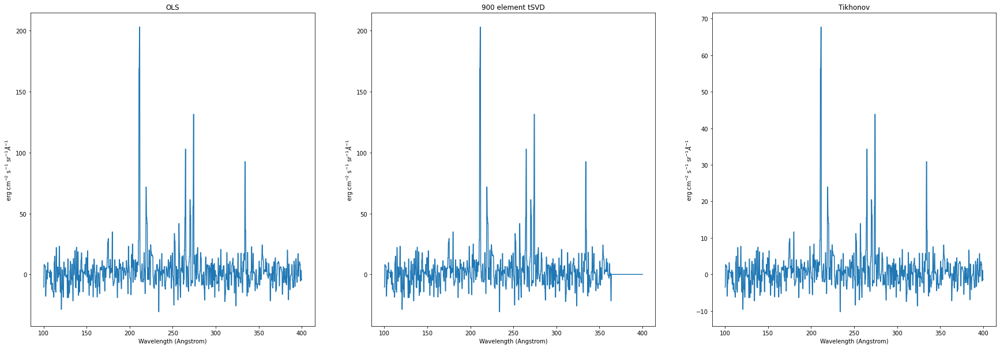

In [28]:
plottings_2(fe14,fe14_meas_Dsn10)

downsample with additive Gaussian noise(level=1) fe12, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  # This is added back by InteractiveShellApp.init_path()


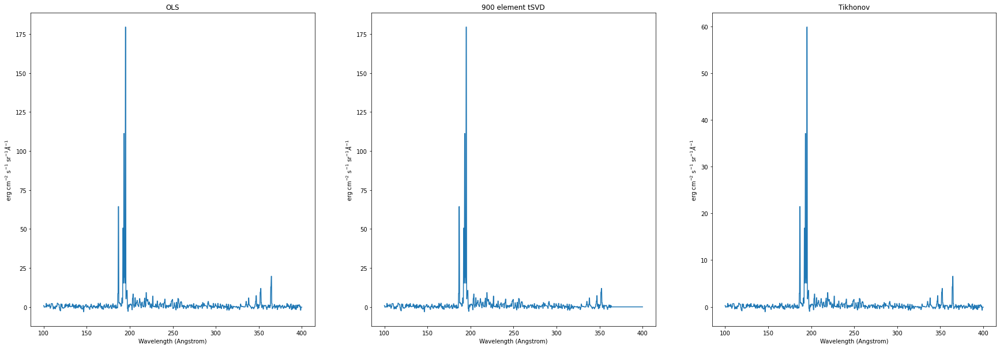

In [29]:
plottings_2(fe12,fe12_meas_Dsn1)

downsample with additive Gaussian noise(level=10) fe12, recovery with OLS, tSVD, Tikhonov

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  # This is added back by InteractiveShellApp.init_path()


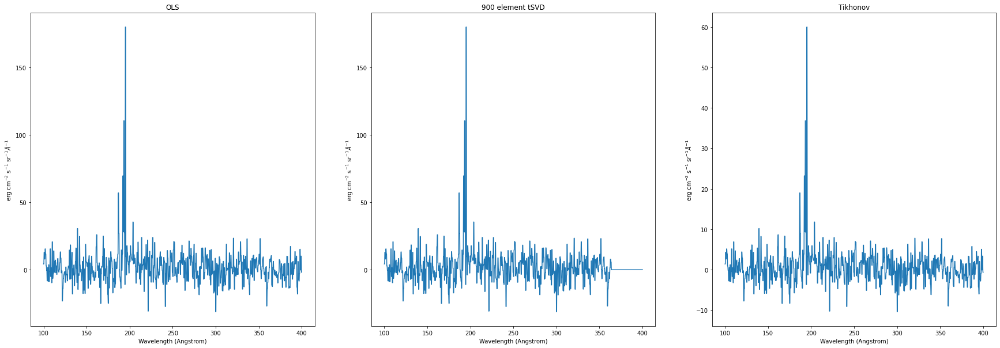

In [30]:
plottings_2(fe12,fe12_meas_Dsn10)

With down sampling matrix, OLS and Tikonov and tSVD are okay for low noised level image, but as the noise level increases, those three methods are not doing well on recovering the noised data. In addition, Tikhonov regularization elimites large signal, that's why the recovered signal using Tikhonov is smaller that others.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

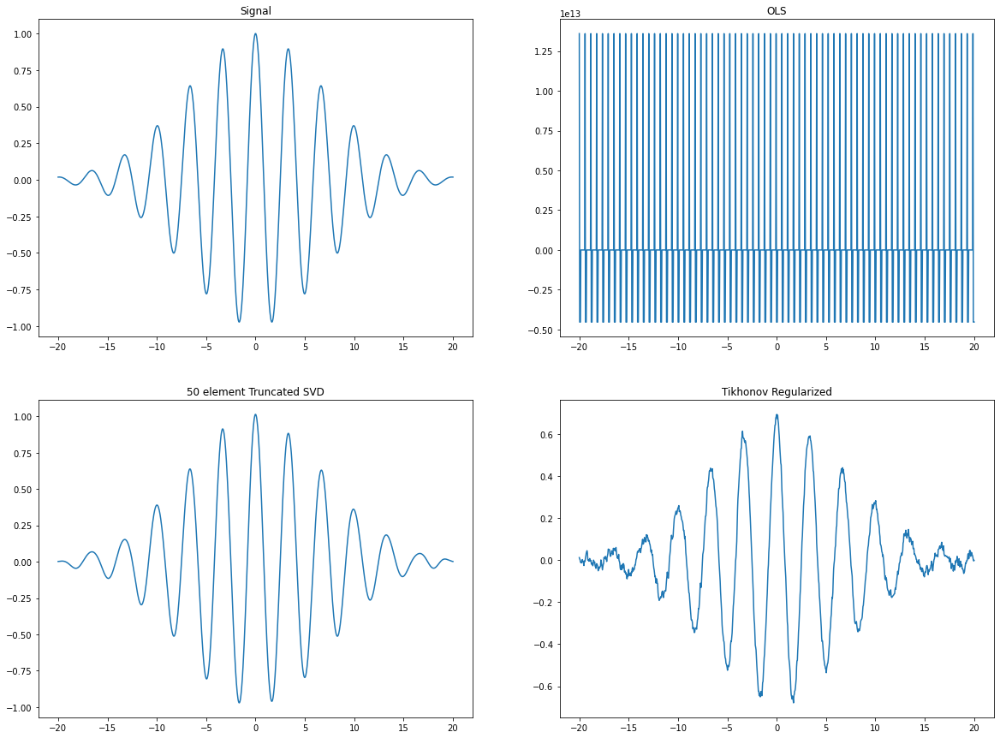

In [39]:
plt.rcParams['figure.figsize'] = [20, 15]
c=np.zeros(1024)
c[0]=1
r=c
r[0:8]=1
H=toeplitz(c,r)

R=1024
noiseLevel=1
lpam=10
#H=np.random.random((R,1024))-.5
u, lam, vh = np.linalg.svd(H)
badRank=800
H=np.matmul(np.matmul(u[:,0:badRank],np.diag(lam[0:badRank])),vh[0:badRank,:])+0.05*np.matmul(np.matmul(u[:,badRank:1024],np.diag(lam[badRank:1024])),vh[badRank:1024,:])
xD=np.linspace(-20,20,1024)
fSig=np.exp(-xD**2/100)*np.cos(2*np.pi*xD*0.3)
#
#
plt.subplot(2,2,1)
plt.plot(xD,fSig)
plt.title('Signal')
plt.subplot(2,2,2)
fe=np.linalg.lstsq(H, np.matmul(H,fSig)+noiseLevel*np.random.normal(scale=1,size=(1024)))[0]
plt.plot(xD,fe)
plt.title('OLS')
plt.subplot(2,2,4)
fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), (np.matmul(H,fSig)+noiseLevel*np.random.normal(scale=1,size=(1024))))
plt.plot(xD,fe)
plt.title('Tikhonov Regularized')
plt.subplot(2,2,3)
reduceRank=50
Hr=np.matmul(np.matmul(np.transpose(vh[0:reduceRank,:]),np.diag(1./lam[0:reduceRank])),np.transpose(u[:,0:reduceRank]))
fe=np.matmul(Hr, (np.matmul(H,fSig)+noiseLevel*np.random.normal(scale=1,size=(1024))))
plt.plot(xD,fe)
plt.title('50 element Truncated SVD')

tSVD performs good in this signal, because the signal is low frequency and the noised is high frequency, tSVD acts like a low pass filter. Tikhonov regularized will prevent the large signal, that why the reconstructured signal has lower value. As for OLS, it failed to reconstruct the signal.

# Problem 3

In [1]:
import numpy as np
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow.keras.datasets import cifar10
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
from scipy import interpolate as interp
from scipy.special import expit
from google.colab import files
import imageio
from PIL import Image
import cv2
%matplotlib inline

Activation functions:
1. Relu
2. Sigmoid

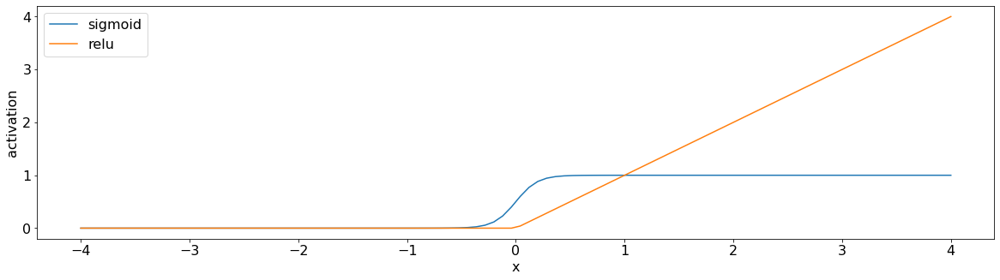

In [2]:
plt.rcParams['figure.figsize'] = [20, 5]
plt.rcParams.update({'font.size': 16})

def sigmoid(x):
  return 1/(1+np.exp(-x))
def relu(x):
  return np.maximum(0,x)

x = np.linspace(-4,4,100)
plt.plot(x, sigmoid(10*x), label='sigmoid')
plt.plot(x, relu(x), label='relu')
plt.xlabel('x')
plt.ylabel('activation')
plt.legend()

In [3]:
!pip install visualkeras
!pip install rawpy
import visualkeras
import rawpy
!wget --no-check-certificate --content-disposition 'https://github.com/djbradyAtOpticalSciencesArizona/computationalImaging/raw/master/images/rawColor.dng'

     |████████████████████████████████| 795 kB 1.1 MB/s 
     |████████████████████████████████| 1.7 MB 4.2 MB/s 
--2021-09-29 01:15:12--  https://github.com/djbradyAtOpticalSciencesArizona/computationalImaging/raw/master/images/rawColor.dng
Resolving github.com (github.com)... 13.114.40.48
Connecting to github.com (github.com)|13.114.40.48|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/djbradyAtOpticalSciencesArizona/computationalImaging/master/images/rawColor.dng [following]
--2021-09-29 01:15:13--  https://raw.githubusercontent.com/djbradyAtOpticalSciencesArizona/computationalImaging/master/images/rawColor.dng
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 24141248 (23M) [application/octet

Download image dataset for training

In [4]:
!wget --no-check-certificate -r -nH --cut-dirs=2 --no-parent --reject="index.html*" https://www.math.purdue.edu/~lucier/PHOTO_CD/D65_TIFF_IMAGES/

--2021-09-29 01:15:15--  https://www.math.purdue.edu/~lucier/PHOTO_CD/D65_TIFF_IMAGES/
Resolving www.math.purdue.edu (www.math.purdue.edu)... 128.210.40.74
Connecting to www.math.purdue.edu (www.math.purdue.edu)|128.210.40.74|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5974 (5.8K) [text/html]
Saving to: ‘D65_TIFF_IMAGES/index.html.tmp’

D65_TIFF_IMAGES/ind 100%[===================>]   5.83K  --.-KB/s    in 0s      

2021-09-29 01:15:16 (211 MB/s) - ‘D65_TIFF_IMAGES/index.html.tmp’ saved [5974/5974]

Loading robots.txt; please ignore errors.
--2021-09-29 01:15:16--  https://www.math.purdue.edu/robots.txt
Reusing existing connection to www.math.purdue.edu:443.
HTTP request sent, awaiting response... 404 Not Found
2021-09-29 01:15:16 ERROR 404: Not Found.

Removing D65_TIFF_IMAGES/index.html.tmp since it should be rejected.

--2021-09-29 01:15:16--  https://www.math.purdue.edu/~lucier/PHOTO_CD/D65_TIFF_IMAGES/?C=N;O=D
Reusing existing connection to www.math.p

image pre-processing:

total images: 24

image size: (2048,3072,3)

Combine those images into im, to form a (24,2048,3072,3) sizes images package

In [5]:
im = np.zeros((24,2048,3072,3))
for pop in range(1,10):
  fileN = "D65_TIFF_IMAGES/IMG000"+np.str(pop)+".tif"
  imm = Image.open(fileN)
  imm = np.array(imm)
  w,h,c =imm.shape
  if w > h:
    imm = imm.transpose(1,0,2)
  im[pop-1,:,:,:]=np.array(imm)/255.
for pop in range(10,25):
  fileN="D65_TIFF_IMAGES/IMG00"+np.str(pop)+".tif"
  imm = Image.open(fileN)
  imm = np.array(imm)
  w,h, c =imm.shape
  if w > h:
    imm = imm.transpose(1,0,2)
  im[pop-1,:,:,:]=np.array(imm)/255.

(24, 2048, 3072, 3)


(-0.5, 3071.5, 2047.5, -0.5)

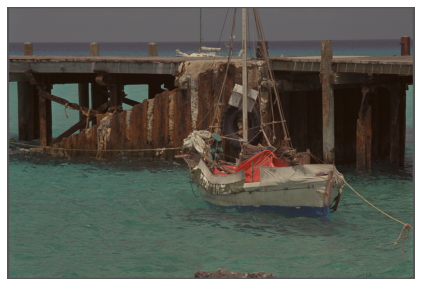

In [6]:
print(im.shape)
plt.imshow(im[10,:,:,:])
plt.axis('off')

Create a kernal for mosaicing image:

In [7]:
def bayerCFA(shape,dtype='none'):
    kernel = np.array([[[1,0,0],[0,0,0]],[[0,0,0],[0,0,0]]])
    kernel = np.stack((kernel,np.array([[[0,0,0],[0,1,0]],[[0,0,0],[0,0,0]]]),np.array([[[0,0,0],[0,0,0]],[[0,1,0],[0,0,0]]]),np.array([[[0,0,0],[0,0,0]],[[0,0,0],[0,0,1]]] )),axis=-1)
    return kernel

Create a single-layered 2D convolution network to mosaic the images.

Input: RGB image (N,M,3)

Output: mosaiced image (N/2,M/2,4)

Purpose of this network is to create training dataset.

In [8]:
inputs = layers.Input(shape=(None,None,3))
cfa = layers.Conv2D(4, (2,2), (2,2), use_bias=False, input_shape=(32,32,3),kernel_initializer=bayerCFA)(inputs)
cfaSample = Model(inputs,cfa)


Create dataset:

train (test) x data: Using first 20 images with many different sections and passing those images through  a single-layer 2D convolution (self-defined kernel) network to generate mosaic images.

train (test) y data: Using first 20 images with many sections.

traning data size of (7680, 64, 64, 4) will run out of RAM,
so I choose (6000, 64, 64, 4) for my training dataset.




In [9]:
rows = 15
cols = 10

trainS = rows * cols * 20 
testS = rows * cols * 4  

xtrain = np.zeros((trainS,64,64,4))
ytrain = np.zeros((trainS,128,128,3))
xtest = np.zeros((testS,64,64,4))
ytest = np.zeros((testS,128,128,3))

i = 0
for imc in range(20):
  for row in range(rows):
    for column in range(cols):
      ytrain[i,:,:,:] = im[imc,(row*128):((row+1)*128),(column*128):((column+1)*128):,:] # create trainy using first 20 images
      xtrain[i,:,:,:] = cfaSample.predict(im[imc:(imc+1),(row*128):((row+1)*128),(column*128):((column+1)*128):,:]) # create trainx using first 20 images
      i+=1

i = 0
for imc in range(4):
  for row in range(rows):
    for column in range(cols):
      ytest[i,:,:,:] = im[imc+20,(row*128):((row+1)*128),(column*128):((column+1)*128):,:] # create testy using last 4 images
      xtest[i,:,:,:] = cfaSample.predict(im[(imc+20):(imc+21),(row*128):((row+1)*128),(column*128):((column+1)*128):,:]) # create testx using last 4 images
      i+=1

xtrain = np.reshape(xtrain, (len(xtrain), 64, 64, 4))
ytrain = np.reshape(ytrain, (len(ytrain), 128, 128, 3))
xtest = np.reshape(xtest, (len(xtest), 64, 64, 4))
ytest = np.reshape(ytest, (len(ytest), 128, 128, 3))
train_dataset = tf.data.Dataset.from_tensor_slices((xtrain, ytrain))
test_dataset = tf.data.Dataset.from_tensor_slices((xtest,ytest))
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 100

train_dataset = train_dataset.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
test_dataset = test_dataset.batch(BATCH_SIZE)

(-0.5, 1535.5, 1023.5, -0.5)

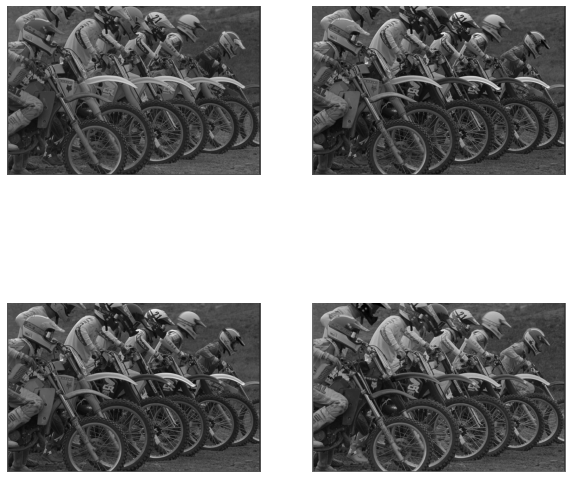

In [10]:
mosaic = cfaSample.predict(im[4:5,:,:,:])
plt.rcParams['figure.figsize'] = [10, 10]
plt.gray()
plt.subplot(2,2,1)
plt.imshow(mosaic[0,:,:,0])
plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(mosaic[0,:,:,1])
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(mosaic[0,:,:,2])
plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(mosaic[0,:,:,3])
plt.axis('off')

Build the network:

I add an additional layer in both encoder and decoder.
I also drop out 20% of the weights in order to prevent overfitting.
Here, I only present the training process of the network which has additional layer and drop out.

loss function: MSE

Optimizer: Adam

In [11]:
inputs = layers.Input(shape=(None,None,4)) # input mosaic images, output demosaic images
# Encoder
x1 = layers.Conv2D(16, (2, 2), strides=2, activation="relu", padding="same")(inputs)
x = layers.MaxPooling2D((2, 2))(x1)
x2 = layers.Conv2D(32, (3, 3), activation="relu", padding="same")(x)
x2 = layers.Dropout(0.2)(x2)
x3 = layers.Conv2D(64, (3, 3), strides=2, activation="relu", padding="same")(x2)
x3 = layers.Dropout(0.2)(x3)
x4 = layers.Conv2D(64, (3, 3), strides=2, activation="relu", padding="same")(x3)
x = layers.MaxPooling2D((2, 2))(x4)
x = layers.Conv2D(128, (3, 3),  activation="relu", padding="same")(x)
# Decoder
x = layers.Conv2DTranspose(128, (3, 3), strides=2, activation="relu", padding="same")(x)
x = layers.Conv2DTranspose(64, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,x3])
x = layers.Conv2DTranspose(32, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,x2])
x = layers.Conv2DTranspose(16, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,x1])
x = layers.Conv2DTranspose(4, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,inputs])
x = layers.Conv2DTranspose(3, (3, 3), strides=2, activation="relu", padding="same")(x)
x = layers.Conv2D(3, (3, 3), activation="linear", padding="same")(x)

# Autoencoder
demosaic = Model(inputs, x)
demosaic.compile(optimizer="adam", loss="mean_squared_error")
demosaic.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 1 272         input_2[0][0]                    
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, None, None, 1 0           conv2d_1[0][0]                   
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, None, None, 3 4640        max_pooling2d[0][0]              
____________________________________________________________________________________________

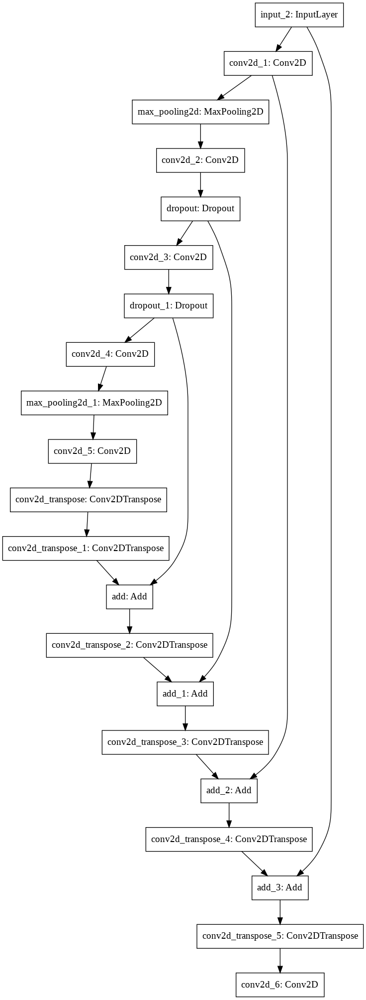

In [12]:
keras.utils.plot_model(demosaic)

Training start!

Ephoch = 30

batch size = 32 

Larger batch size will improve the training process, the loss will decrease more smoothly. If apply smaller batch size, the loss will be fluctuated and the network learns less. In addition, we should shuffle the training data because the network might "cheat" if the order of training data always remains the same. On the other hand, if the network goes deeper, we should have more epochs for training.

I trained 3 models, the first is the original structure in the note, the second has two additional 2D Conv layer. The third has two additional layer with drop out in order to prevent overfitting which occurs in the second model (training loss decrease, testing loss increase in the last few epochs).

In [18]:
epo = 30
demosaic.fit(train_dataset,
    epochs=epo,
    batch_size=BATCH_SIZE,
    shuffle=True,
    validation_data=test_dataset
)

Epoch 1/30
94/94 [==============================] - 5s 53ms/step - loss: 1.5269e-04 - val_loss: 1.5172e-04
Epoch 2/30
94/94 [==============================] - 6s 67ms/step - loss: 1.5098e-04 - val_loss: 1.4268e-04
Epoch 3/30
94/94 [==============================] - 7s 71ms/step - loss: 1.4826e-04 - val_loss: 1.4186e-04
Epoch 4/30
94/94 [==============================] - 7s 74ms/step - loss: 1.4623e-04 - val_loss: 1.3787e-04
Epoch 5/30
94/94 [==============================] - 7s 79ms/step - loss: 1.4415e-04 - val_loss: 1.3667e-04
Epoch 6/30
94/94 [==============================] - 6s 62ms/step - loss: 1.4281e-04 - val_loss: 1.3745e-04
Epoch 7/30
94/94 [==============================] - 5s 51ms/step - loss: 1.4059e-04 - val_loss: 1.3255e-04
Epoch 8/30
94/94 [==============================] - 4s 48ms/step - loss: 1.3872e-04 - val_loss: 1.3189e-04
Epoch 9/30
94/94 [==============================] - 4s 46ms/step - loss: 1.3666e-04 - val_loss: 1.2790e-04
Epoch 10/30
94/94 [==================

Save and download the trained model

In [ ]:
demosaic.save("dropout")
!tar -czvf dropout.tar.gz dropout/
files.download('dropout.tar.gz')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

load the models:

1. original model
2. with additional layer
3. with additional layer and dropout

In [ ]:
!tar -xvf 'original.tar.gz'
!tar -xvf 'additional.tar.gz'
!tar -xvf 'dropoff.tar.gz'

In [ ]:
original = keras.models.load_model('demosaic') # this is the network with less layer
additional = keras.models.load_model('additional') # this is the network with an additional layer
dropout = keras.models.load_model('dropoff') # this is the network with an additional layer and dropout

take a look of the performance of the model using trained image. this results indicate that the deeper nwtwork doesn't always have better performance. We can see that the color performance of the second picture(with additional layer) is the worst. The model is overfitting.

(-0.5, 3071.5, 2047.5, -0.5)

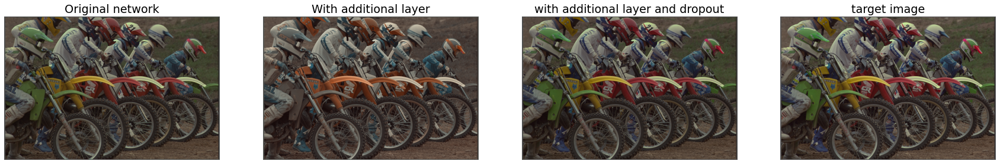

In [ ]:
plt.rcParams['figure.figsize'] = [30, 10]

original_pred = original.predict(cfaSample.predict(im[4:5,:,:,:]))
additional_pred = additional.predict(cfaSample.predict(im[4:5,:,:,:]))
dropout_pred = dropout.predict(cfaSample.predict(im[4:5,:,:,:]))

original_pred = (original_pred / np.max(original_pred) * 255).astype(np.uint8)
additional_pred = (additional_pred / np.max(additional_pred)* 255).astype(np.uint8)
dropout_pred = (dropout_pred / np.max(dropout_pred)* 255).astype(np.uint8)

plt.subplot(1,4,1)
plt.title('Original network')
plt.imshow(original_pred[0,:,:,:])
plt.axis('off')

plt.subplot(1,4,2)
plt.title('With additional layer')
plt.imshow(additional_pred[0,:,:,:])
plt.axis('off')

plt.subplot(1,4,3)
plt.title('with additional layer and dropout')
plt.imshow(dropout_pred[0,:,:,:])
plt.axis('off')

plt.subplot(1,4,4)
plt.title('target image')
plt.imshow(im[4,:,:,:])
plt.axis('off')

Look into more detailed. We can find that the third picture is the most similar to the target image.

(-0.5, 99.5, 99.5, -0.5)

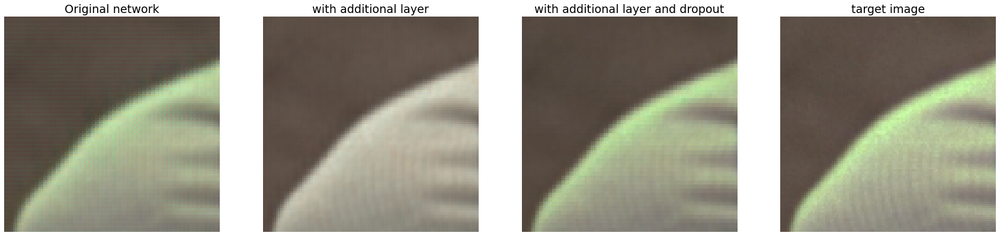

In [ ]:
st = 100
en = 200

plt.subplot(1,4,1)
plt.title('Original network')
plt.imshow(original_pred[0,st:en,st:en,:])
plt.axis('off')

plt.subplot(1,4,2)
plt.title('with additional layer')
plt.imshow(additional_pred[0,st:en,st:en,:])
plt.axis('off')

plt.subplot(1,4,3)
plt.title('with additional layer and dropout')
plt.imshow(dropout_pred[0,st:en,st:en,:])
plt.axis('off')

plt.subplot(1,4,4)
plt.title('target image')
plt.imshow(im[4,st:en,st:en,:])
plt.axis('off')

MSE is the lowest for the network with dropout

In [ ]:
print("Original network: ", mse(original_pred[0,st:en,st:en,:], im[4,st:en,st:en,:]))
print("Additional layer: ", mse(additional_pred[0,st:en,st:en,:], im[4,st:en,st:en,:]))
print("With dropout: ", mse(dropout_pred[0,st:en,st:en,:], im[4,st:en,st:en,:]))

Original network:  43842.31679470512
Additional layer:  49967.7773484306
With dropout:  42972.11755509727


Let's try with my image

(-0.5, 5215.5, 3471.5, -0.5)

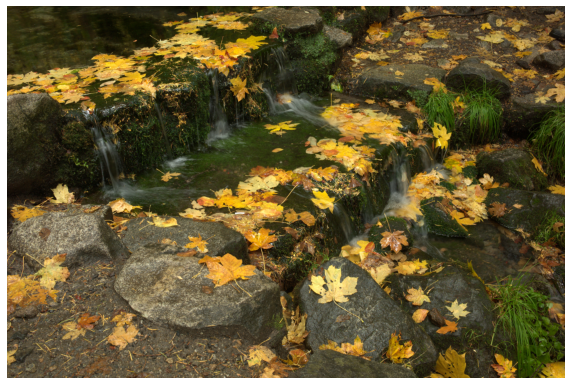

In [15]:
def rgb2bayerGR2(image):
  w,h, c=image.shape
  bayer=np.zeros((w,h))
  bayer[0:w:2,0:h:2]=image[0:w:2,0:h:2,1]
  bayer[1:w:2,1:h:2]=image[1:w:2,1:h:2,1]
  bayer[0:w:2,1:h:2]=image[0:w:2,1:h:2,0]
  bayer[1:w:2,0:h:2]=image[1:w:2,0:h:2,2]
  bayer=255*bayer/np.max(bayer)
  bayer=bayer.astype('uint8')
  return bayer

def bayer2(image):
  w,h=image.shape
  cs=np.zeros((np.int(w/2),np.int(h/2),4))
  cs[:,:,0]=image[0:w:2,1:h:2]
  cs[:,:,1]=image[0:w:2,0:h:2]
  cs[:,:,2]=image[1:w:2,1:h:2]
  cs[:,:,3]=image[1:w:2,0:h:2]
  cs=cs/np.max(cs)
  cs=np.reshape(cs, (1, np.int(w/2), np.int(h/2), 4))
  return cs


raw = rawpy.imread('sample1.DNG')
rawImage = raw.raw_image_visible[0:1024,0:1536]
plt.imshow(raw.postprocess())
plt.axis('off')

(-0.5, 1535.5, 1023.5, -0.5)

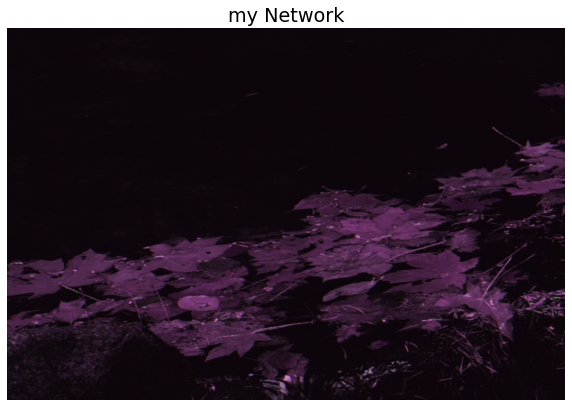

In [19]:
img_test = bayer2(rawImage)

MyPred = demosaic.predict(img_test)[0,:,:,:]
MyPred = (MyPred / np.max(MyPred) * 255).astype(np.uint8)

plt.title('my Network')
plt.imshow(MyPred)
plt.axis('off')

(-0.5, 1535.5, 1023.5, -0.5)

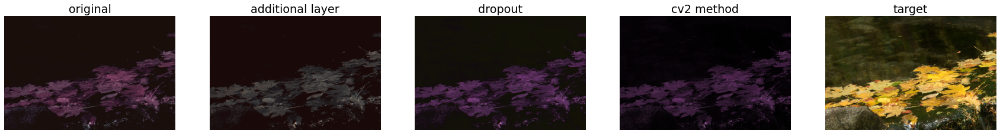

In [ ]:
plt.rcParams['figure.figsize'] = [30, 10]
img_test = bayer2(rawImage)

original_pred = original.predict(img_test)[0,:,:,:]
original_pred = (original_pred / np.max(original_pred) * 255).astype(np.uint8)

additional_pred = additional.predict(img_test)[0,:,:,:]
additional_pred = (additional_pred / np.max(additional_pred) * 255).astype(np.uint8)

dropout_pred = dropout.predict(img_test)[0,:,:,:]
dropout_pred = (dropout_pred / np.max(dropout_pred) * 255).astype(np.uint8)

cv2_method = cv2.cvtColor(rawImage, cv2.COLOR_BayerGR2BGR)
cv2_method = (cv2_method / np.max(cv2_method) * 255).astype(np.uint8)

target = raw.postprocess()[0:1024,0:1536,:]
target = (target / np.max(target) * 255).astype(np.uint8)

plt.subplot(1,5,1)
plt.title('original')
plt.imshow(original_pred)
plt.axis('off')

plt.subplot(1,5,2)
plt.title('additional layer')
plt.imshow(additional_pred)
plt.axis('off')

plt.subplot(1,5,3)
plt.title('dropout')
plt.imshow(dropout_pred)
plt.axis('off')

plt.subplot(1,5,4)
plt.title('cv2 method')
plt.imshow(cv2_method)
plt.axis('off')

plt.subplot(1,5,5)
plt.title('target')
plt.imshow(target)
plt.axis('off')

It seems that my predict images are having wrong color, maybe it is because of not enough diversity of training dataset, and my DNG image is so different from training dataset.